<a href="https://colab.research.google.com/github/nagolinc/notebooks/blob/main/TADNE_and_CLIP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Scoring images from TADNE (This Anime does not exist) with CLIP

In [ ]:
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)

if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

CUDA version: 10.1


In [ ]:
! pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex

Looking in links: https://download.pytorch.org/whl/torch_stable.html


In [ ]:
import numpy as np
import torch

print("Torch version:", torch.__version__)

Torch version: 1.7.1+cu101


# Downloading the model

CLIP models are distributed as TorchScript modules.

In [ ]:
MODELS = {
    "ViT-B/32":       "https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt",
}

In [ ]:
! wget {MODELS["ViT-B/32"]} -O model.pt

--2021-01-20 15:26:06--  https://openaipublic.azureedge.net/clip/models/40d365715913c9da98579312b702a82c18be219cc2a73407c4526f58eba950af/ViT-B-32.pt
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.13, 2620:1ec:bdf::13
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 353976522 (338M) [application/octet-stream]
Saving to: ‘model.pt’

model.pt            100%[===================>] 337.58M  65.8MB/s    in 5.4s    

2021-01-20 15:26:12 (62.2 MB/s) - ‘model.pt’ saved [353976522/353976522]



In [ ]:
model = torch.jit.load("model.pt").cuda().eval()
input_resolution = model.input_resolution.item()
context_length = model.context_length.item()
vocab_size = model.vocab_size.item()

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


# Image Preprocessing

We resize the input images and center-crop them to conform with the image resolution that the model expects. Before doing so, we will normalize the pixel intensity using the dataset mean and standard deviation.



In [ ]:
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from PIL import Image

preprocess = Compose([
    Resize(input_resolution, interpolation=Image.BICUBIC),
    CenterCrop(input_resolution),
    ToTensor()
])

image_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).cuda()
image_std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).cuda()

# Text Preprocessing

We use a case-insensitive tokenizer. The tokenizer code is hidden in the second cell below

In [ ]:
! pip install ftfy regex
! wget https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz -O bpe_simple_vocab_16e6.txt.gz

--2021-01-20 15:29:00--  https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.246.13, 2620:1ec:bdf::13
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.246.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1356917 (1.3M) [application/octet-stream]
Saving to: ‘bpe_simple_vocab_16e6.txt.gz’

bpe_simple_vocab_16 100%[===================>]   1.29M  6.32MB/s    in 0.2s    

2021-01-20 15:29:00 (6.32 MB/s) - ‘bpe_simple_vocab_16e6.txt.gz’ saved [1356917/1356917]



In [ ]:
#@title

import gzip
import html
import os
from functools import lru_cache

import ftfy
import regex as re


@lru_cache()
def bytes_to_unicode():
    """
    Returns list of utf-8 byte and a corresponding list of unicode strings.
    The reversible bpe codes work on unicode strings.
    This means you need a large # of unicode characters in your vocab if you want to avoid UNKs.
    When you're at something like a 10B token dataset you end up needing around 5K for decent coverage.
    This is a signficant percentage of your normal, say, 32K bpe vocab.
    To avoid that, we want lookup tables between utf-8 bytes and unicode strings.
    And avoids mapping to whitespace/control characters the bpe code barfs on.
    """
    bs = list(range(ord("!"), ord("~")+1))+list(range(ord("¡"), ord("¬")+1))+list(range(ord("®"), ord("ÿ")+1))
    cs = bs[:]
    n = 0
    for b in range(2**8):
        if b not in bs:
            bs.append(b)
            cs.append(2**8+n)
            n += 1
    cs = [chr(n) for n in cs]
    return dict(zip(bs, cs))


def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs


def basic_clean(text):
    text = ftfy.fix_text(text)
    text = html.unescape(html.unescape(text))
    return text.strip()


def whitespace_clean(text):
    text = re.sub(r'\s+', ' ', text)
    text = text.strip()
    return text


class SimpleTokenizer(object):
    def __init__(self, bpe_path: str = "bpe_simple_vocab_16e6.txt.gz"):
        self.byte_encoder = bytes_to_unicode()
        self.byte_decoder = {v: k for k, v in self.byte_encoder.items()}
        merges = gzip.open(bpe_path).read().decode("utf-8").split('\n')
        merges = merges[1:49152-256-2+1]
        merges = [tuple(merge.split()) for merge in merges]
        vocab = list(bytes_to_unicode().values())
        vocab = vocab + [v+'</w>' for v in vocab]
        for merge in merges:
            vocab.append(''.join(merge))
        vocab.extend(['<|startoftext|>', '<|endoftext|>'])
        self.encoder = dict(zip(vocab, range(len(vocab))))
        self.decoder = {v: k for k, v in self.encoder.items()}
        self.bpe_ranks = dict(zip(merges, range(len(merges))))
        self.cache = {'<|startoftext|>': '<|startoftext|>', '<|endoftext|>': '<|endoftext|>'}
        self.pat = re.compile(r"""<\|startoftext\|>|<\|endoftext\|>|'s|'t|'re|'ve|'m|'ll|'d|[\p{L}]+|[\p{N}]|[^\s\p{L}\p{N}]+""", re.IGNORECASE)

    def bpe(self, token):
        if token in self.cache:
            return self.cache[token]
        word = tuple(token[:-1]) + ( token[-1] + '</w>',)
        pairs = get_pairs(word)

        if not pairs:
            return token+'</w>'

        while True:
            bigram = min(pairs, key = lambda pair: self.bpe_ranks.get(pair, float('inf')))
            if bigram not in self.bpe_ranks:
                break
            first, second = bigram
            new_word = []
            i = 0
            while i < len(word):
                try:
                    j = word.index(first, i)
                    new_word.extend(word[i:j])
                    i = j
                except:
                    new_word.extend(word[i:])
                    break

                if word[i] == first and i < len(word)-1 and word[i+1] == second:
                    new_word.append(first+second)
                    i += 2
                else:
                    new_word.append(word[i])
                    i += 1
            new_word = tuple(new_word)
            word = new_word
            if len(word) == 1:
                break
            else:
                pairs = get_pairs(word)
        word = ' '.join(word)
        self.cache[token] = word
        return word

    def encode(self, text):
        bpe_tokens = []
        text = whitespace_clean(basic_clean(text)).lower()
        for token in re.findall(self.pat, text):
            token = ''.join(self.byte_encoder[b] for b in token.encode('utf-8'))
            bpe_tokens.extend(self.encoder[bpe_token] for bpe_token in self.bpe(token).split(' '))
        return bpe_tokens

    def decode(self, tokens):
        text = ''.join([self.decoder[token] for token in tokens])
        text = bytearray([self.byte_decoder[c] for c in text]).decode('utf-8', errors="replace").replace('</w>', ' ')
        return text


# Setting up input images and texts

We are going to feed 8 example images and their textual descriptions to the model, and compare the similarity between the corresponding features.

The tokenizer is case-insensitive, and we can freely give any suitable textual descriptions.

In [ ]:
import os
import skimage
import IPython.display
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

from collections import OrderedDict
import torch

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# images in skimage to use and their textual descriptions
descriptions = {
    "page": "a page of text about segmentation",
    "chelsea": "a facial photo of a tabby cat",
    "astronaut": "a portrait of an astronaut with the American flag",
    "rocket": "a rocket standing on a launchpad",
    "motorcycle_right": "a red motorcycle standing in a garage",
    "camera": "a person looking at a camera on a tripod",
    "horse": "a black-and-white silhouette of a horse", 
    "coffee": "a cup of coffee on a saucer",
    "kitty": "a cute little kitty cat"
}

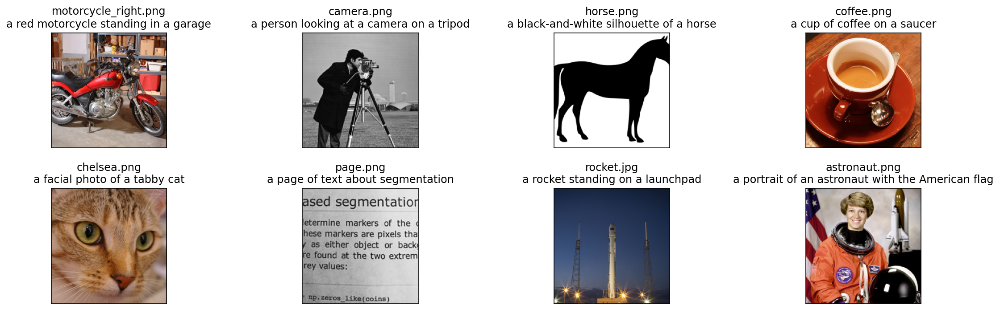

In [ ]:
images = []
texts = []
plt.figure(figsize=(16, 5))

for filename in [filename for filename in os.listdir(skimage.data_dir) if filename.endswith(".png") or filename.endswith(".jpg")]:
    name = os.path.splitext(filename)[0]
    if name not in descriptions:
        continue

    image = preprocess(Image.open(os.path.join(skimage.data_dir, filename)).convert("RGB"))
    images.append(image)
    texts.append(descriptions[name])

    plt.subplot(2, 4, len(images))
    plt.imshow(image.permute(1, 2, 0))
    plt.title(f"{filename}\n{descriptions[name]}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()


## Building features

We normalize the images, tokenize each text input, and run the forward pass of the model to get the image and text features.

In [ ]:
image_input = torch.tensor(np.stack(images)).cuda()
image_input -= image_mean[:, None, None]
image_input /= image_std[:, None, None]

In [ ]:
texts+=["a cute little kitty cat"]

In [ ]:
tokenizer = SimpleTokenizer()
text_tokens = [tokenizer.encode("This is " + desc) for desc in texts]

In [ ]:
text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
sot_token = tokenizer.encoder['<|startoftext|>']
eot_token = tokenizer.encoder['<|endoftext|>']

for i, tokens in enumerate(text_tokens):
    tokens = [sot_token] + tokens + [eot_token]
    text_input[i, :len(tokens)] = torch.tensor(tokens)

text_input = text_input.cuda()

In [ ]:
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_input).float()

## Calculating cosine similarity

We normalize the features and calculate the dot product of each pair.

In [ ]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

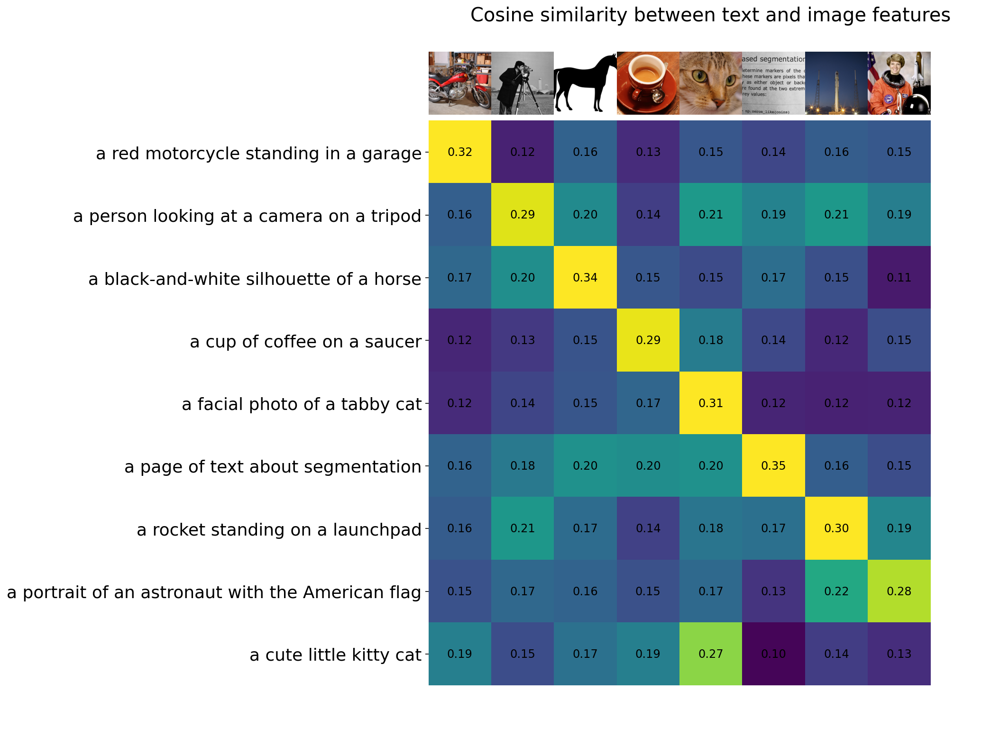

In [ ]:
count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(images):
    plt.imshow(image.permute(1, 2, 0), extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

# Zero-Shot Image Classification

You can classify images using the cosine similarity (times 100) as the logits to the softmax operation.

In [ ]:
from torchvision.datasets import CIFAR100

cifar100 = CIFAR100(os.path.expanduser("~/.cache"), transform=preprocess, download=True)

Files already downloaded and verified


In [ ]:
text_descriptions = [f"This is a photo of a {label}" for label in cifar100.classes]
text_tokens = [[sot_token] + tokenizer.encode(desc) + [eot_token] for desc in text_descriptions]
text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)

for i, tokens in enumerate(text_tokens):
    text_input[i, :len(tokens)] = torch.tensor(tokens)

text_input = text_input.cuda()
text_input.shape

torch.Size([100, 77])

In [ ]:
with torch.no_grad():
    text_features = model.encode_text(text_input).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)

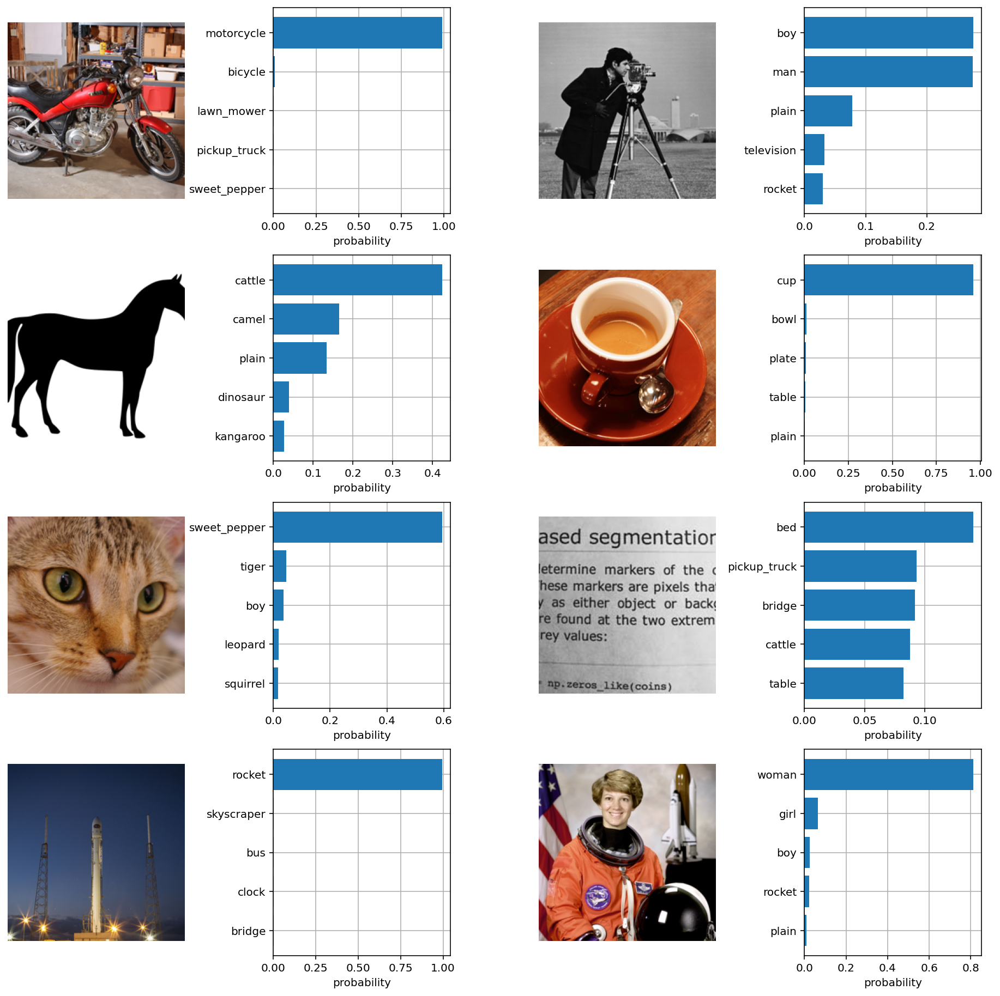

In [ ]:
plt.figure(figsize=(16, 16))

for i, image in enumerate(images):
    plt.subplot(4, 4, 2 * i + 1)
    plt.imshow(image.permute(1, 2, 0))
    plt.axis("off")

    plt.subplot(4, 4, 2 * i + 2)
    y = np.arange(top_probs.shape[-1])
    plt.grid()
    plt.barh(y, top_probs[i])
    plt.gca().invert_yaxis()
    plt.gca().set_axisbelow(True)
    plt.yticks(y, [cifar100.classes[index] for index in top_labels[i].numpy()])
    plt.xlabel("probability")

plt.subplots_adjust(wspace=0.5)
plt.show()

# This Anime Does Not Exist - Interpolation Videos

This notebook generates interpolation videos from the model used for https://thisanimedoesnotexist.ai by [@aydao](https://aydao.ai).

Notebook by [@arfa](https://twitter.com/arfafax).

To run it, click "Open in playground" above, and then Runtime > Run All.

In [ ]:
!nvidia-smi

Wed Jan 20 15:26:41 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    40W / 300W |   1799MiB / 16130MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!git clone https://github.com/shawwn/stylegan2 -b estimator /content/stylegan2

fatal: destination path '/content/stylegan2' already exists and is not an empty directory.


In [ ]:
import gdown
gdown.download('https://drive.google.com/uc?id=1qNhyusI0hwBLI-HOavkNP5I0J0-kcN4C', 'network-tadne.pkl', quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1qNhyusI0hwBLI-HOavkNP5I0J0-kcN4C
To: /content/network-tadne.pkl
1.06GB [00:06, 160MB/s]


'network-tadne.pkl'

In [ ]:
%tensorflow_version 1.x
%cd /content/stylegan2

TensorFlow 1.x selected.
/content/stylegan2


In [ ]:
import os
import pickle
import numpy as np
import PIL.Image
import dnnlib
import dnnlib.tflib as tflib
import scipy



attach_debugger <function attach_debugger at 0x7f562d9fa730>
print_status <function print_status at 0x7f562d9fa7b8>
freeze_forever <function freeze_forever at 0x7f562d9fa9d8>
quit <function quit at 0x7f562d9faa60>
save_and_quit <function save_and_quit at 0x7f562d9fac80>
throw_exception <function throw_exception at 0x7f562d9fad90>


In [ ]:
tflib.init_tf()
_G, _D, Gs = pickle.load(open("/content/network-tadne.pkl", "rb"))
# _G = Instantaneous snapshot of the generator. Mainly useful for resuming a previous training run.
# _D = Instantaneous snapshot of the discriminator. Mainly useful for resuming a previous training run.
# Gs = Long-term average of the generator. Yields higher-quality results than the instantaneous snapshot.

Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.


In [ ]:
 def make_video(grid_size = [4, 4], duration_sec = 60.0, mp4_fps = 20, random_seed=397):
    #tflib.init_tf()

    #_G, _D, Gs = pickle.load(open("/content/network-e621.pkl", "rb"))
    # _G = Instantaneous snapshot of the generator. Mainly useful for resuming a previous training run.
    # _D = Instantaneous snapshot of the discriminator. Mainly useful for resuming a previous training run.
    # Gs = Long-term average of the generator. Yields higher-quality results than the instantaneous snapshot.

    image_shrink = 1
    image_zoom = 1
    smoothing_sec = 1.0
    mp4_codec = 'libx264'
    mp4_bitrate = '5M'
    mp4_file = 'random_grid_%s.mp4' % random_seed
    minibatch_size = 8

    num_frames = int(np.rint(duration_sec * mp4_fps))
    random_state = np.random.RandomState(random_seed)

    # Generate latent vectors
    shape = [num_frames, np.prod(grid_size)] + Gs.input_shape[1:] # [frame, image, channel, component]
    all_latents = random_state.randn(*shape).astype(np.float32)
    import scipy
    all_latents = scipy.ndimage.gaussian_filter(all_latents,
                   [smoothing_sec * mp4_fps] + [0] * len(Gs.input_shape), mode='wrap')
    all_latents /= np.sqrt(np.mean(np.square(all_latents)))


    def create_image_grid(images, grid_size=None):
        assert images.ndim == 3 or images.ndim == 4
        num, img_h, img_w, channels = images.shape

        if grid_size is not None:
            grid_w, grid_h = tuple(grid_size)
        else:
            grid_w = max(int(np.ceil(np.sqrt(num))), 1)
            grid_h = max((num - 1) // grid_w + 1, 1)

        grid = np.zeros([grid_h * img_h, grid_w * img_w, channels], dtype=images.dtype)
        for idx in range(num):
            x = (idx % grid_w) * img_w
            y = (idx // grid_w) * img_h
            grid[y : y + img_h, x : x + img_w] = images[idx]
        return grid

    # Frame generation func for moviepy.
    def make_frame(t):
        frame_idx = int(np.clip(np.round(t * mp4_fps), 0, num_frames - 1))
        latents = all_latents[frame_idx]
        fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
        images = Gs.run(latents, None, truncation_psi=1.0,
                              randomize_noise=False, output_transform=fmt)

        grid = create_image_grid(images, grid_size)
        if image_zoom > 1:
            grid = scipy.ndimage.zoom(grid, [image_zoom, image_zoom, 1], order=0)
        if grid.shape[2] == 1:
            grid = grid.repeat(3, 2) # grayscale => RGB
        return grid

    # Generate video.
    import moviepy.editor
    video_clip = moviepy.editor.VideoClip(make_frame, duration=duration_sec)
    video_clip.write_videofile(mp4_file, fps=mp4_fps, codec=mp4_codec, bitrate=mp4_bitrate)

    return mp4_file


In [ ]:
import math
from PIL import ImageFont
from PIL import ImageDraw
def interpolate_between_seeds(seed_array, truncation, duration_sec = 10.0, smoothing_sec = 1.0, mp4_fps = 20, filename=None, text=True):
    #_G, _D, Gs = pickle.load(open("/content/network-e621.pkl", "rb"))
    noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]
    if seed_array[0] != seed_array[-1]:
        seed_array.append(seed_array[0])
    
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    synthesis_kwargs = dict(output_transform=Gs_kwargs.output_transform, truncation_psi=truncation, minibatch_size=8)
    if truncation is not None:
        Gs_kwargs.truncation_psi = truncation
    rnd = np.random.RandomState(seed_array[0])
    tflib.set_vars({var: rnd.randn(*var.shape.as_list()) for var in noise_vars}) # [height, width]
    batch_size = 1
    all_seeds = seed_array #[seed] * batch_size
    all_z = np.stack([np.random.RandomState(seed).randn(*Gs.input_shape[1:]) for seed in all_seeds]) # [minibatch, component]
    #print(all_z)
    #print(all_z.shape)
    all_w = []

    labels = []
    for i, seed in enumerate(seed_array):
        z = np.stack([np.random.RandomState(seed).randn(*Gs.input_shape[1:])])
        #print(i, seed, z)
        all_w_src = Gs.components.mapping.run(z, None) # [minibatch, layer, component]
        if truncation != 1:
            w_avg = Gs.get_var('dlatent_avg')
            all_w_src = w_avg + (all_w_src - w_avg) * truncation # [minibatch, layer, component]
        all_w.append(all_w_src)
    #print(all_w)
    #print(len(all_w))
        
    num_frames = int(np.rint(duration_sec * mp4_fps))
        
    def make_frame(t):
        blend = ((len(seed_array)-1)*t/duration_sec)%1.0
        src_i = math.floor((t/duration_sec)*(len(seed_array)-1))
        dst_i = src_i + 1
        #print(t, blend, src_i, dst_i)
        all_w_new = (blend * all_w[dst_i]) + (1 - blend) * all_w[src_i]
        all_images_src = Gs.components.synthesis.run(all_w_new, randomize_noise=False, **synthesis_kwargs)
        #all_images_dst = Gs.components.synthesis.run(all_w_dst, randomize_noise=False, **synthesis_kwargs)
        if text:
            new_im = PIL.Image.new('RGB', (512, 600))
            new_im.paste(PIL.Image.fromarray(np.median(all_images_src, axis=0).astype(np.uint8)), (0, 0))
            draw = ImageDraw.Draw(new_im)
            font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf", size=16)
            draw.text((10, 512), "{:0.2f}".format((1-blend)), (255, 0, 0), font=font)
            draw.text((50, 512), str(seed_array[src_i]), (255, 255, 255), font=font)
            draw.text((10, 550), "{:0.2f}".format((blend)), (0, 255, 0), font=font)
            draw.text((50, 550), str(seed_array[dst_i]), (255, 255, 255), font=font)
            return np.array(new_im)
        else:
            return all_images_src[0]

    
    import moviepy.editor
    mp4_file = 'interp_%s-%s.mp4' % (seed_array, truncation)
    if filename:
        mp4_file = filename
    mp4_codec = 'libx264'
    mp4_bitrate = '5M'

    video_clip = moviepy.editor.VideoClip(make_frame, duration=duration_sec)
    video_clip.write_videofile(mp4_file, fps=mp4_fps, codec=mp4_codec, bitrate=mp4_bitrate)
    
    return mp4_file

In [ ]:
 from numpy import linalg
 import moviepy.editor
 def circular_interpolation(seed_a, seed_b, seed_c, radius = 40.0):
    rnd = np.random
    latents_a = np.random.RandomState(seed_a).randn(1, Gs.input_shape[1])
    latents_b = np.random.RandomState(seed_b).randn(1, Gs.input_shape[1])
    latents_c = np.random.RandomState(seed_c).randn(1, Gs.input_shape[1])

    def circ_generator(latents_interpolate):
        #radius = 40.0

        latents_axis_x = (latents_a - latents_b).flatten() / linalg.norm(latents_a - latents_b)
        latents_axis_y = (latents_a - latents_c).flatten() / linalg.norm(latents_a - latents_c)

        latents_x = math.sin(math.pi * 2.0 * latents_interpolate) * radius
        latents_y = math.cos(math.pi * 2.0 * latents_interpolate) * radius

        latents = latents_a + latents_x * latents_axis_x + latents_y * latents_axis_y
        return latents

    def mse(x, y):
        return (np.square(x - y)).mean()

    def generate_from_generator_adaptive(gen_func):
        max_step = 1.0
        current_pos = 0.0

        change_min = 10.0
        change_max = 11.0

        fmt = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)

        current_latent = gen_func(current_pos)
        current_image = Gs.run(current_latent, None, truncation_psi=0.7, randomize_noise=False, output_transform=fmt)[0]
        array_list = []

        video_length = 1.0
        while(current_pos < video_length):
            array_list.append(current_image)

            lower = current_pos
            upper = current_pos + max_step
            current_pos = (upper + lower) / 2.0

            current_latent = gen_func(current_pos)
            current_image = images = Gs.run(current_latent, None, truncation_psi=0.7, randomize_noise=False, output_transform=fmt)[0]
            current_mse = mse(array_list[-1], current_image)

            while current_mse < change_min or current_mse > change_max:
                if current_mse < change_min:
                    lower = current_pos
                    current_pos = (upper + lower) / 2.0

                if current_mse > change_max:
                    upper = current_pos
                    current_pos = (upper + lower) / 2.0


                current_latent = gen_func(current_pos)
                current_image = images = Gs.run(current_latent, None, truncation_psi=0.7, randomize_noise=False, output_transform=fmt)[0]
                current_mse = mse(array_list[-1], current_image)
            print(current_pos, current_mse)
        return array_list

    frames = generate_from_generator_adaptive(circ_generator)
    frames = moviepy.editor.ImageSequenceClip(frames, fps=30)

    # Generate video.
    print("Generating video")
    mp4_file = 'circular_%s-%s-%s-%s.mp4' % (seed_a, seed_b, seed_c, radius)
    #mp4_file = 'results/circular.mp4'
    mp4_codec = 'libx264'
    mp4_bitrate = '3M'
    mp4_fps = 20

    frames.write_videofile(mp4_file, fps=mp4_fps, codec=mp4_codec, bitrate=mp4_bitrate)
    return mp4_file

In [ ]:
 def generate_images(seeds, truncation_psi,show=False):
    #_G, _D, Gs = pickle.load(open("/content/network-e621.pkl", "rb"))
    noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    if truncation_psi is not None:
        Gs_kwargs.truncation_psi = truncation_psi

    output=[]

    for seed_idx, seed in enumerate(seeds):
        if show:
          print('Generating image for seed %d (%d/%d) ...' % (seed, seed_idx, len(seeds)))
        rnd = np.random.RandomState(seed)
        z = rnd.randn(1, *Gs.input_shape[1:]) # [minibatch, component]
        #print(z)
        tflib.set_vars({var: rnd.randn(*var.shape.as_list()) for var in noise_vars}) # [height, width]
        images = Gs.run(z, None, **Gs_kwargs) # [minibatch, height, width, channel]
        PIL.Image.fromarray(images[0], 'RGB').save('seed%04d.png' % seed)
        if show:
          display(PIL.Image.fromarray(images[0], 'RGB'))
        output+=[images[0]]
    return output

In [ ]:
 def blend_images(src_seed, dst_seed, blending=0.5, truncation_psi=0.7):
    #_G, _D, Gs = pickle.load(open("/content/network-e621.pkl", "rb"))
    noise_vars = [var for name, var in Gs.components.synthesis.vars.items() if name.startswith('noise')]
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    synthesis_kwargs = dict(output_transform=Gs_kwargs.output_transform, truncation_psi=truncation_psi, minibatch_size=8)
    if truncation_psi is not None:
        Gs_kwargs.truncation_psi = truncation_psi

    all_w = []

    for i, seed in enumerate([src_seed, dst_seed]):
        z = np.stack([np.random.RandomState(seed).randn(*Gs.input_shape[1:])])
        #print(i, seed, z)
        all_w_src = Gs.components.mapping.run(z, None) # [minibatch, layer, component]
        if truncation_psi != 1:
            w_avg = Gs.get_var('dlatent_avg')
            all_w_src = w_avg + (all_w_src - w_avg) * truncation_psi # [minibatch, layer, component]
        all_w.append(all_w_src)
    
    w_new = (blending * all_w[0]) + (1 - blending) * all_w[1]
    images = Gs.components.synthesis.run(w_new, randomize_noise=False, **synthesis_kwargs)

    PIL.Image.fromarray(images[0], 'RGB').save('seed%04d.png' % seed)
    display(PIL.Image.fromarray(images[0], 'RGB'))

In [ ]:
from IPython.display import display, HTML

from IPython.display import HTML

def display_mp4(path):
    print(f'Read from {path}')
    from base64 import b64encode
    mp4 = open(path,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML("""
    <video controls loop autoplay>
        <source src="%s" type="video/mp4">
    </video>
    """ % data_url))
    print('Display finished.')

In [ ]:
36143

36143

Generating image for seed 36143 (0/5) ...


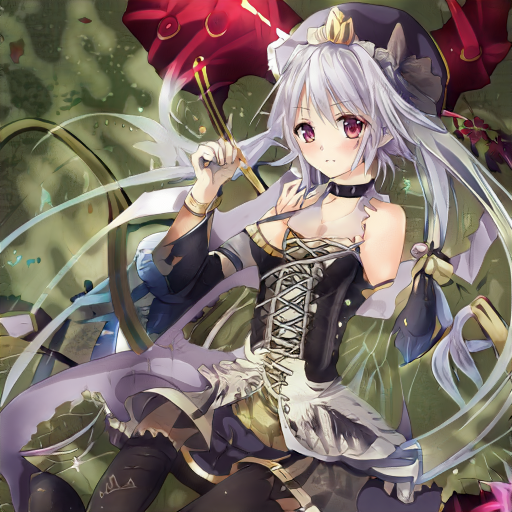

Generating image for seed 12243 (1/5) ...


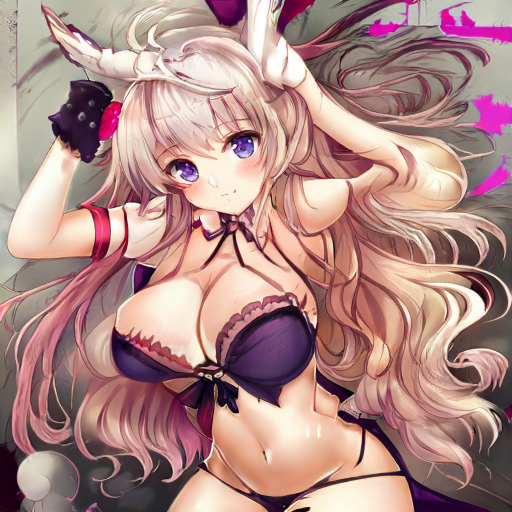

Generating image for seed 18551 (2/5) ...


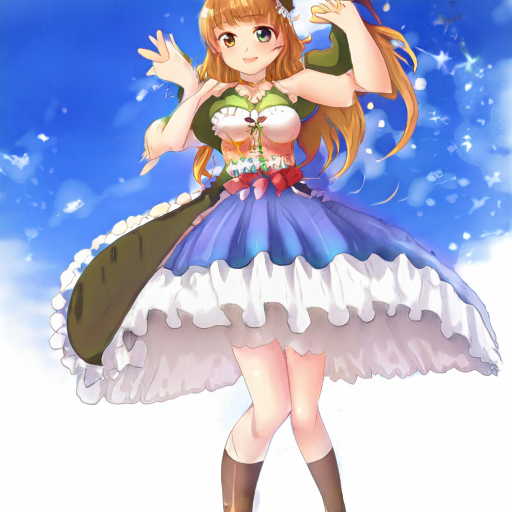

Generating image for seed 26000 (3/5) ...


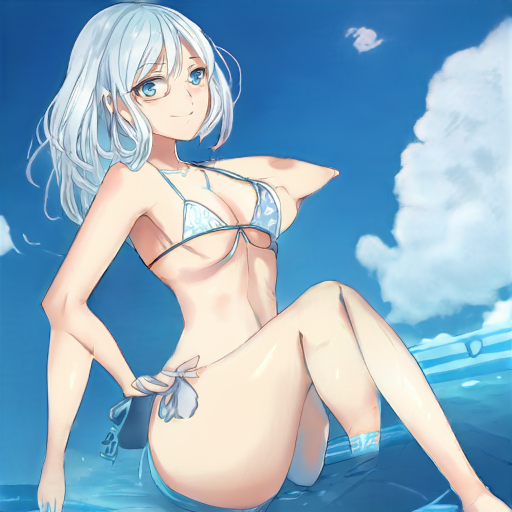

Generating image for seed 996 (4/5) ...


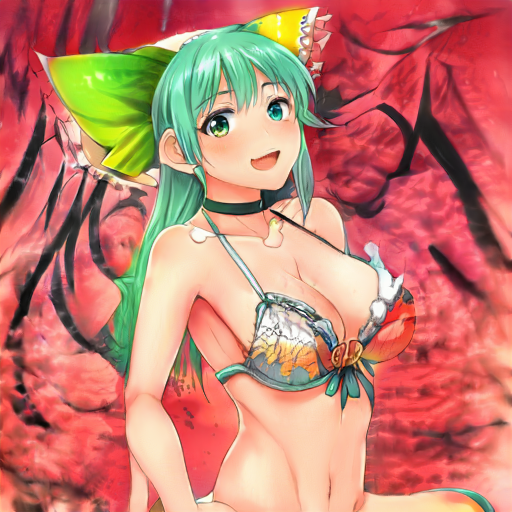

In [ ]:
#@title Generate an image { run: "auto", form-width: "30%"}
random_seeds = [
  36143, #black dress
  12243,#purple bikini
  18551,#blue dress
  26000,#blue bikini
  996 #red bikini
]
truncation_psi = 1.0 #@param {type:"slider", min:0, max:2, step:0.05}
generated_images = generate_images(random_seeds, truncation_psi,show=True)


In [ ]:
#preprocessing step to get image ready for CLIP

images=[preprocess(PIL.Image.fromarray(img, 'RGB')) for img in generated_images]
texts=["an anime drawing of a girl in a black dress",
       "an anime drawing of a girl in a purple bikini",
       "an anime drawing of a girl in a blue dress",
       "an anime drawing of a girl in a blue bikini",
       "a girl with green hair and a red bikini",
       "a girl with blue hair",
       "a girl with brown hair"]



In [ ]:
image_input = torch.tensor(np.stack(images)).cuda()
image_input -= image_mean[:, None, None]
image_input /= image_std[:, None, None]

In [ ]:
tokenizer = SimpleTokenizer()
text_tokens = [tokenizer.encode("This is " + desc) for desc in texts]

In [ ]:
text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
sot_token = tokenizer.encoder['<|startoftext|>']
eot_token = tokenizer.encoder['<|endoftext|>']

for i, tokens in enumerate(text_tokens):
    tokens = [sot_token] + tokens + [eot_token]
    text_input[i, :len(tokens)] = torch.tensor(tokens)

text_input = text_input.cuda()

In [ ]:
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_input).float()

In [ ]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

Text(0.5, 1.0, 'Cosine similarity between text and image features')

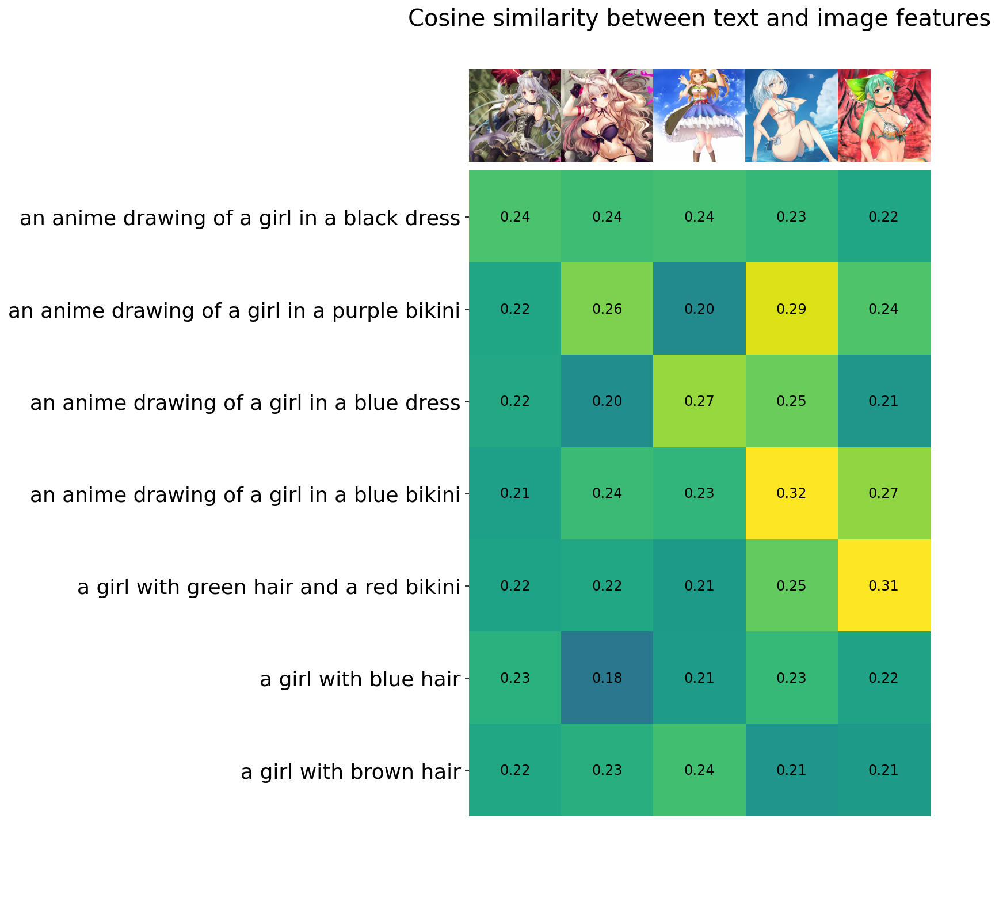

In [ ]:
count = len(images)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
plt.yticks(range(len(texts)), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(images):
    plt.imshow(image.permute(1, 2, 0), extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, len(images) - 0.5])
plt.ylim([len(texts) + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=20)

In [ ]:
from torchvision.datasets import CIFAR100

cifar100 = CIFAR100(os.path.expanduser("~/.cache"), transform=preprocess, download=True)

Files already downloaded and verified


In [ ]:
labels=cifar100.classes+['anime']

In [ ]:
text_descriptions = [f"This is a photo of a {label}" for label in labels]
text_tokens = [[sot_token] + tokenizer.encode(desc) + [eot_token] for desc in text_descriptions]
text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)

for i, tokens in enumerate(text_tokens):
    text_input[i, :len(tokens)] = torch.tensor(tokens)

text_input = text_input.cuda()
text_input.shape

torch.Size([101, 77])

In [ ]:
with torch.no_grad():
    text_features = model.encode_text(text_input).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (101.0 * image_features @ text_features.T).softmax(dim=-1)
top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)

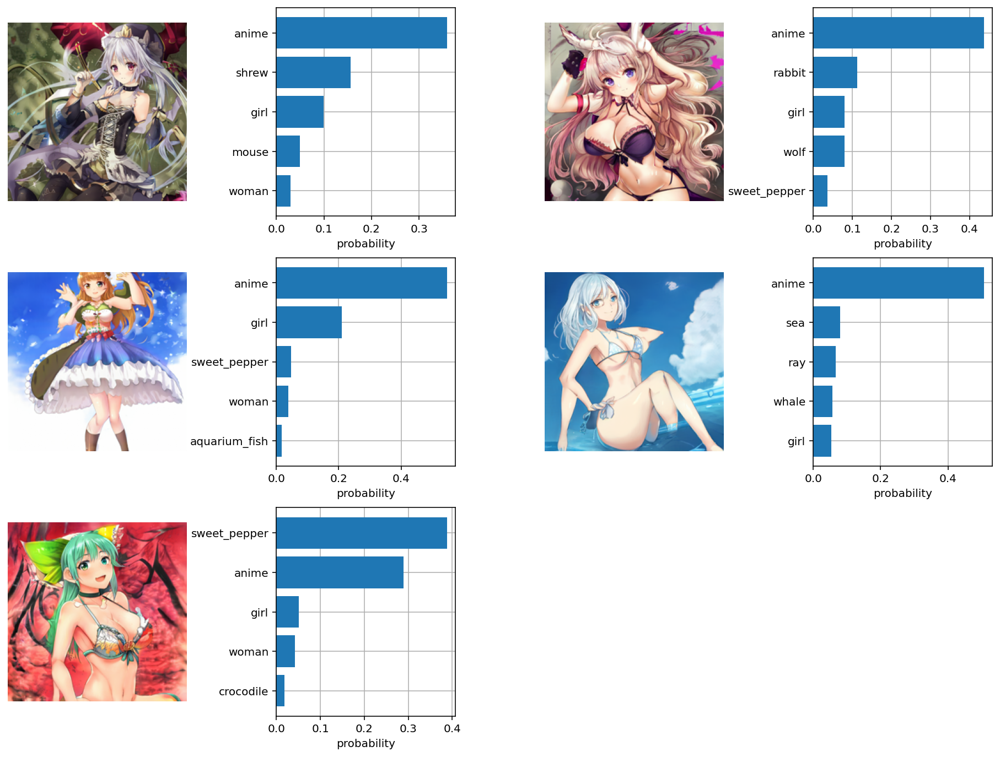

In [ ]:
plt.figure(figsize=(16, 16))

for i, image in enumerate(images):
    plt.subplot(4, 4, 2 * i + 1)
    plt.imshow(image.permute(1, 2, 0))
    plt.axis("off")

    plt.subplot(4, 4, 2 * i + 2)
    y = np.arange(top_probs.shape[-1])
    plt.grid()
    plt.barh(y, top_probs[i])
    plt.gca().invert_yaxis()
    plt.gca().set_axisbelow(True)
    plt.yticks(y, [labels[index] for index in top_labels[i].numpy()])
    plt.xlabel("probability")

plt.subplots_adjust(wspace=0.5)
plt.show()

# Experiment 2 (Sampling based off of CLIP descriptions)

In [ ]:
from tqdm.notebook import tqdm, trange

In [ ]:

generated_images = [generate_images([i], truncation_psi)[0] for i in trange(1000)]
images=[preprocess(PIL.Image.fromarray(img, 'RGB')) for img in generated_images]


In [ ]:
images=[preprocess(PIL.Image.fromarray(img, 'RGB')) for img in generated_images]
image_input = torch.tensor(np.stack(images)).cuda()
image_input -= image_mean[:, None, None]
image_input /= image_std[:, None, None]

with torch.no_grad():
    image_features = model.encode_image(image_input).float()

image_features /= image_features.norm(dim=-1, keepdim=True)

In [ ]:
texts=["a girl wearing a {color} {article}".format(color=color,article=article) 
  for color in ["red","green","blue","white","black"]
  for article in ["shirt","pants","skirt","dress","bikini"]]

tokenizer = SimpleTokenizer()
text_tokens = [tokenizer.encode("This is " + desc) for desc in texts]

text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
sot_token = tokenizer.encoder['<|startoftext|>']
eot_token = tokenizer.encoder['<|endoftext|>']

for i, tokens in enumerate(text_tokens):
    tokens = [sot_token] + tokens + [eot_token]
    text_input[i, :len(tokens)] = torch.tensor(tokens)

text_input = text_input.cuda()

with torch.no_grad():
    text_features = model.encode_text(text_input).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

In [ ]:
len(texts)

25

In [ ]:
text_features.shape

torch.Size([25, 512])

In [ ]:
image_features.shape

torch.Size([1000, 512])

In [ ]:
text_probs = (image_features @ text_features.T).softmax(dim=0)#get best image for each label
top_probs, top_labels = text_probs.cpu().topk(5, dim=0)#top 5

a girl wearing a red shirt


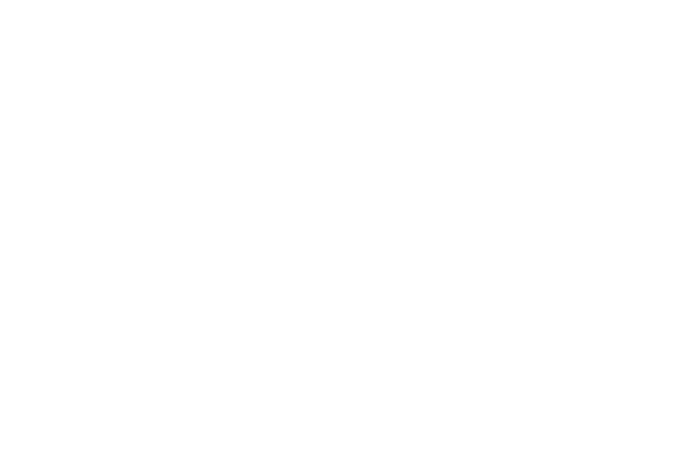

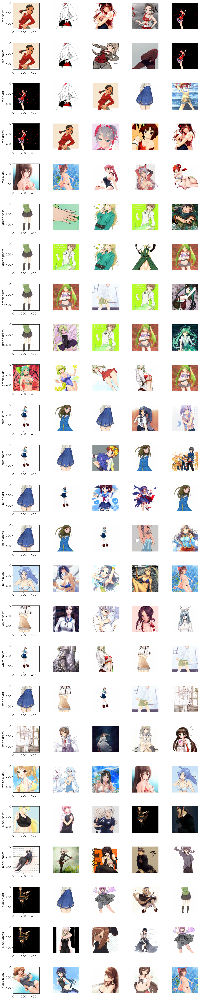

In [ ]:
shortTexts=["{color} {article}".format(color=color,article=article) 
  for color in ["red","green","blue","white","black"]
  for article in ["shirt","pants","skirt","dress","bikini"]]

print(texts[0])
plt.axis('off')
fig, axes = plt.subplots(nrows=25, ncols=5, figsize=(10, 25*2))
fig.tight_layout()


  
for row in trange(25):
  for i,l in enumerate(top_labels[:,row]):
    axis=plt.subplot(25,5,i+1+row*5)
    plt.imshow(generated_images[l])
    if i==0:
      axis.set_ylabel(shortTexts[row])
      pass
    else:
      pass
      plt.axis('off')


  

In [138]:
texts=["a girl with {color} {artifact}".format(color=color,artifact=artifact) 
  for color in ["red","green","blue","white","black"]
  for artifact in ["hair","eyes","clothing","background"]]


shortTexts=["{color} {artifact}".format(color=color,artifact=artifact) 
  for color in ["red","green","blue","white","black"]
  for artifact in ["hair","eyes","clothing","background"]]


tokenizer = SimpleTokenizer()
text_tokens = [tokenizer.encode("This is " + desc) for desc in texts]

text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)
sot_token = tokenizer.encoder['<|startoftext|>']
eot_token = tokenizer.encoder['<|endoftext|>']

for i, tokens in enumerate(text_tokens):
    tokens = [sot_token] + tokens + [eot_token]
    text_input[i, :len(tokens)] = torch.tensor(tokens)

text_input = text_input.cuda()

with torch.no_grad():
    text_features = model.encode_text(text_input).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (image_features @ text_features.T).softmax(dim=0)#get best image for each label
top_probs, top_labels = text_probs.cpu().topk(5, dim=0)#top 5

a girl with red hair


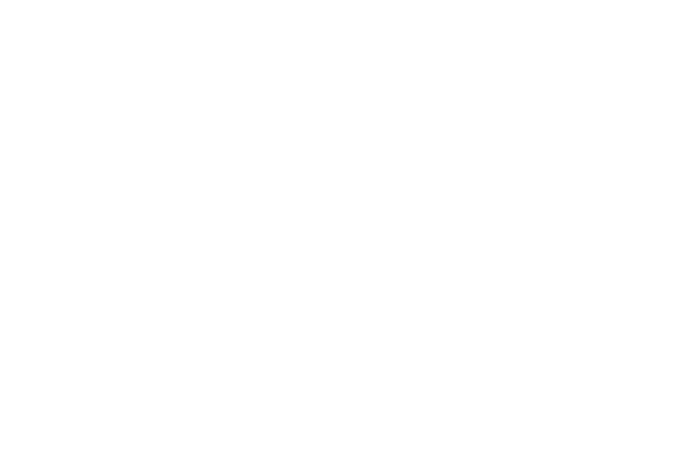

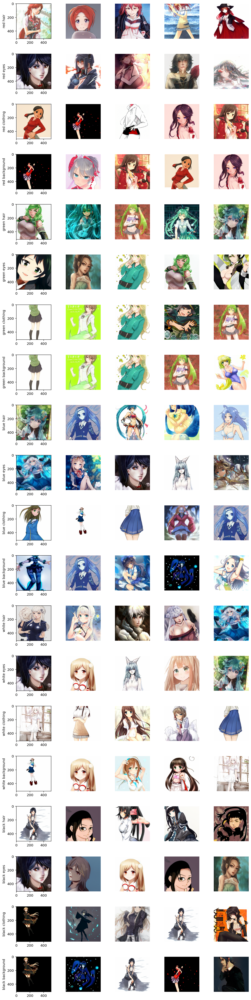

In [140]:


print(texts[0])
plt.axis('off')
fig, axes = plt.subplots(nrows=25, ncols=5, figsize=(10, len(texts)*2))
fig.tight_layout()


  
for row in trange(len(texts)):
  for i,l in enumerate(top_labels[:,row]):
    axis=plt.subplot(len(texts),5,i+1+row*5)
    plt.imshow(generated_images[l])
    if i==0:
      axis.set_ylabel(shortTexts[row])
      pass
    else:
      pass
      plt.axis('off')

#Random start and Hill Climbing

In [143]:
def doTheWork(seed=36143,description="an anime drawing of a girl in a black dress",psi=1.0):
  #this is a bad idea, but let's try just using scipy.optimize
  latent = np.random.RandomState(seed).randn(1, Gs.input_shape[1])

  texts=[description]

  #preprocess text
  tokenizer = SimpleTokenizer()
  text_tokens = [tokenizer.encode("This is " + desc) for desc in texts]
  text_input = torch.zeros(len(text_tokens), model.context_length, dtype=torch.long)

  for i, tokens in enumerate(text_tokens):
      text_input[i, :len(tokens)] = torch.tensor(tokens)

  text_input = text_input.cuda()
  print("text input",text_input.shape)

  preprocess = Compose([
      Resize(input_resolution, interpolation=Image.BICUBIC),
      CenterCrop(input_resolution),
      ToTensor()
  ])

  def scoreLatents(latents,psi=psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    if psi is not None:
        Gs_kwargs.truncation_psi = psi
    imgs = Gs.run(latents, None, **Gs_kwargs)
    #print("imgs",imgs.shape)
    #_img=torch.from_numpy(img)
    #resize=Resize(input_resolution)
    #print(_rimg.shape)
    #image_input = _rimg
    images=[preprocess(PIL.Image.fromarray(img, 'RGB')) for img in imgs]
    image_input = torch.tensor(np.stack(images)).cuda()
    image_input -= image_mean[:, None, None]
    image_input /= image_std[:, None, None]
    
    with torch.no_grad():
      image_features = model.encode_image(image_input).float()
      text_features = model.encode_text(text_input).float()
    #compute similarity
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    #print("features",image_features.shape,text_features.shape)
    similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T
    #print("similarity",similarity.shape)
    return similarity[0]

  def displayLatent(latent,psi=psi):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    if psi is not None:
        Gs_kwargs.truncation_psi = psi
    images = Gs.run(latent, None, **Gs_kwargs)
    return PIL.Image.fromarray(images[0], 'RGB')
    
    
  #print("score",scoreLatents(latent))
  #displayLatent(latent)

  return latent,scoreLatents,displayLatent

text input torch.Size([1, 77])


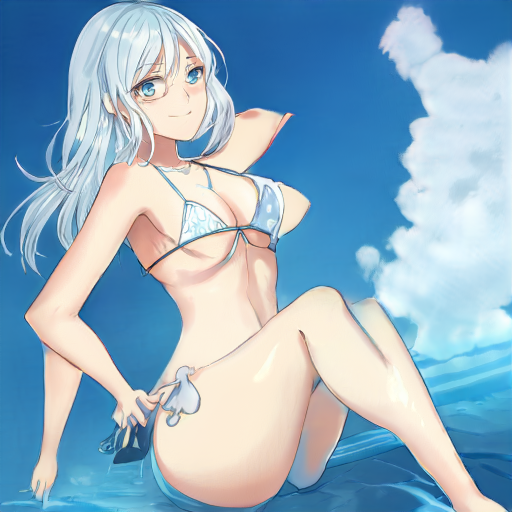

In [145]:
latent,scoreLatents,displayLatent=doTheWork(26000)
display(displayLatent(latent))

In [199]:
def optimize(start,scoreLatents,_delta=1/2**15,_density=1/1000,rounds=10,batchSize=10):
  v0=start.copy()
  score0=scoreLatents(v0)[0]
  delta=_delta
  print("score0",score0)
  for i in range(rounds):
    newLatents=np.tile(v0,(batchSize,1))+np.random.randn(*(batchSize,1024))*delta*(np.random.random(size=(batchSize,1024))<_density)
    newScores=scoreLatents(newLatents)
    bestScore=np.max(newScores)
    if bestScore>score0:
      print("new best score",i,bestScore)
      t=np.argmax(newScores)
      v0=newLatents[t].reshape(1,1024)
      score0=bestScore
    else:
      delta/=2
    #can't let delta get too small
    if delta<2**-32:
      print("reset delta",i)
      delta=_delta
  return v0
  

In [202]:
start=np.random.randn(*latent.shape)
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)

score0 0.1447755
new best score 0 0.19142747
new best score 1 0.20752764
new best score 2 0.22462252
new best score 3 0.22545442
new best score 5 0.23924315
new best score 9 0.24383728
new best score 11 0.24536112
new best score 12 0.2482522
new best score 13 0.24838413
new best score 14 0.24914289
new best score 16 0.2507313
new best score 17 0.2529228
new best score 20 0.2537231
new best score 21 0.25424975
new best score 23 0.25465617
new best score 24 0.25527224
new best score 27 0.25530255
new best score 28 0.25543442
new best score 31 0.25548893
new best score 32 0.25562263
new best score 34 0.25563896
new best score 36 0.2556486
new best score 39 0.2556624
new best score 40 0.2556867
new best score 52 0.2557412
reset delta 57
reset delta 90


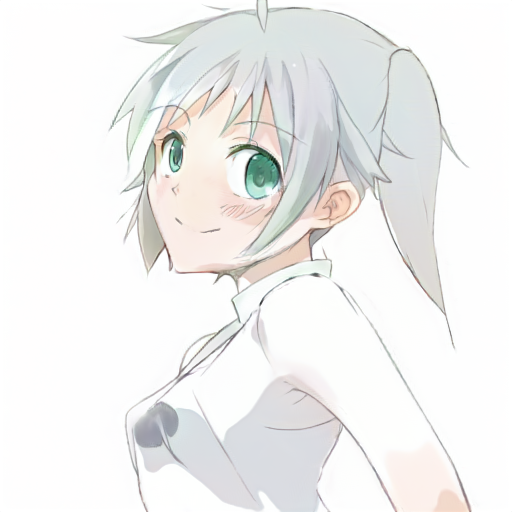

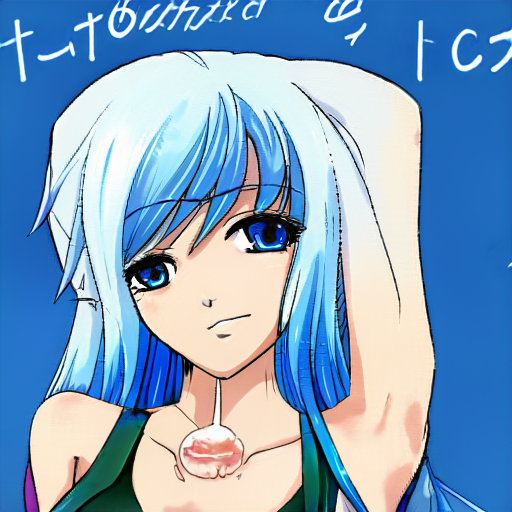

In [203]:
display(displayLatent(start))
display(displayLatent(result))

In [204]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl with blue hair",psi=0.5)
start=np.random.randn(*latent.shape)
display(displayLatent(start))
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))


text input torch.Size([1, 77])
score0 0.11779705
new best score 0 0.18608773
new best score 1 0.2124821
new best score 2 0.2185423
new best score 3 0.22039673
new best score 4 0.223537
new best score 6 0.22584473
new best score 8 0.24391454
new best score 9 0.24407703
new best score 10 0.2597153
new best score 16 0.2612725
new best score 17 0.26166916
new best score 18 0.26210326
new best score 19 0.26292366
new best score 20 0.26301003
new best score 21 0.26383513
new best score 23 0.26445305
new best score 24 0.2648065
new best score 25 0.26513663
new best score 26 0.26676488
new best score 27 0.26679468
new best score 28 0.26689678
new best score 29 0.26737633
new best score 30 0.26765388
new best score 31 0.26784497
new best score 32 0.26823342
new best score 33 0.2685758
new best score 36 0.26892686
new best score 37 0.2692214
new best score 38 0.26941863
new best score 40 0.2697934
new best score 46 0.26982996
new best score 47 0.26984578
new best score 48 0.26984975
new best sco

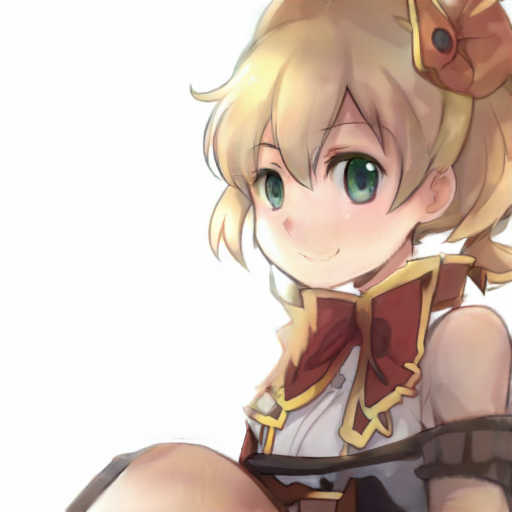

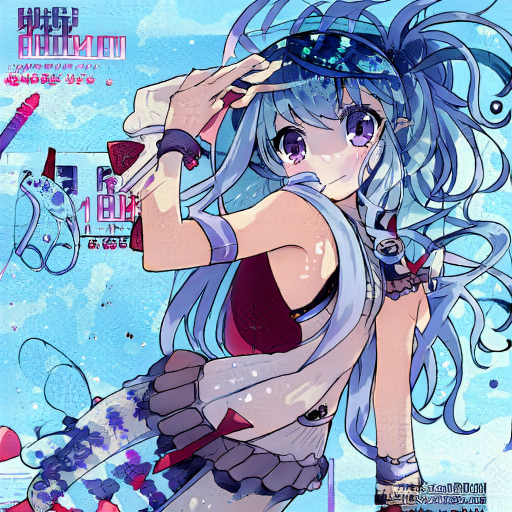

In [219]:
#how much worse is this than random sampling?
randomBatch=[np.random.randn(*latent.shape) for i in range(1000)]
scores=[scoreLatents(l) for l in tqdm(randomBatch)]
np.max(scores)
top5=np.argsort(np.array(scores).flatten())[-5:] #normal distribution is key not not getting hideous monstrosoties!
print(np.array(scores).flatten()[top5])
[display(displayLatent(randomBatch[t])) for t in top5]
top5Latents=[randomBatch[t] for t in top5]

0.24519666

[0.20860256 0.20960706 0.2096374  0.21732807 0.24519666]


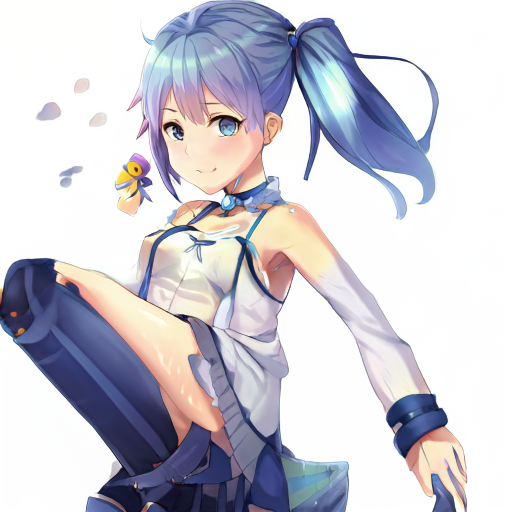

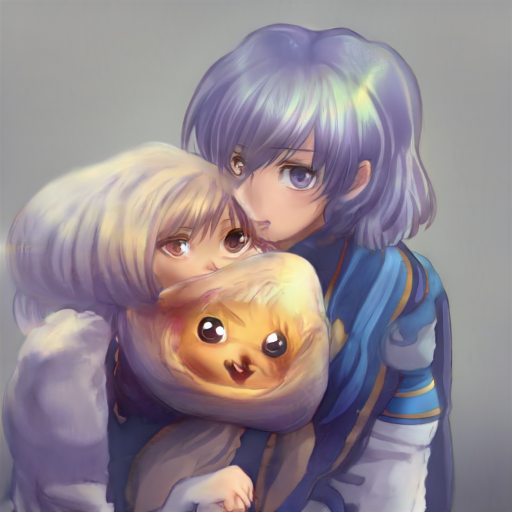

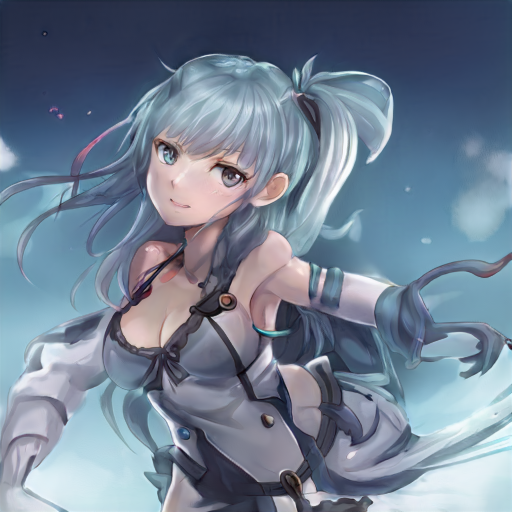

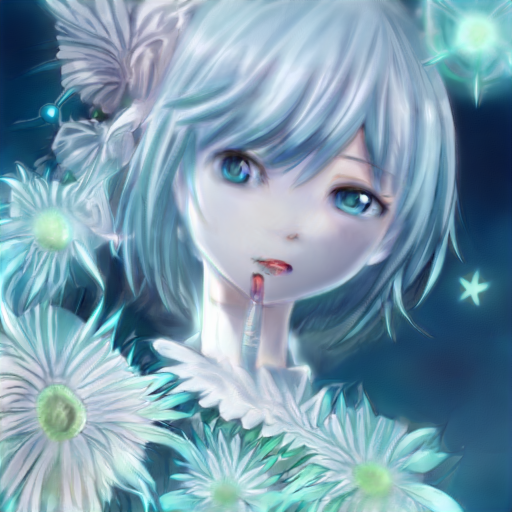

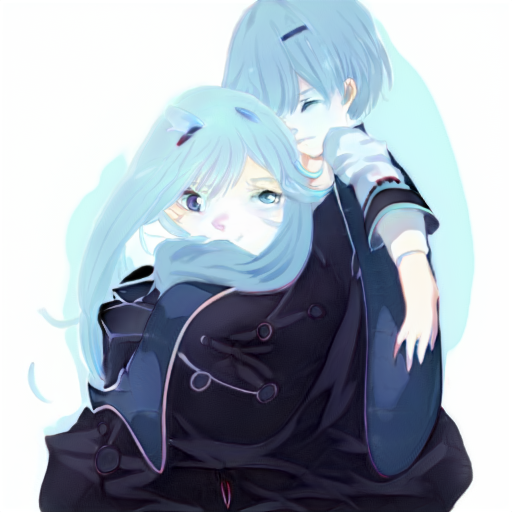

In [220]:
top5=np.argsort(np.array(scores).flatten())[-5:] #normal distribution is key not not getting hideous monstrosoties!
print(np.array(scores).flatten()[top5])
[display(displayLatent(randomBatch[t])) for t in top5]
top5Latents=[randomBatch[t] for t in top5]

In [222]:
#top5Latents[-1].shape
scoreLatents(top5Latents[-1])

result=optimize(top5Latents[-1],scoreLatents,rounds=100,_density=1,_delta=1)


score0 0.24507043
new best score 4 0.24714011
new best score 5 0.24740346
new best score 6 0.24943428
new best score 8 0.252145
new best score 9 0.25461122
new best score 11 0.25592655
new best score 13 0.25793597
new best score 15 0.25830102
new best score 16 0.25857556
new best score 17 0.25916636
new best score 18 0.25974458
new best score 20 0.2601131
new best score 21 0.26052254
new best score 24 0.26066044
new best score 27 0.26070783
new best score 28 0.26080006
new best score 30 0.2608405
new best score 32 0.26087338
new best score 33 0.26089612
new best score 34 0.260963
new best score 42 0.2609769
new best score 50 0.2609823
new best score 51 0.26098627
reset delta 55
new best score 64 0.26102853
new best score 65 0.2611507
new best score 67 0.26194814
new best score 69 0.26228416
new best score 71 0.26255745
new best score 73 0.26256922
new best score 75 0.26263124
new best score 78 0.26267365
new best score 81 0.26272336
new best score 82 0.26272595
new best score 83 0.2627

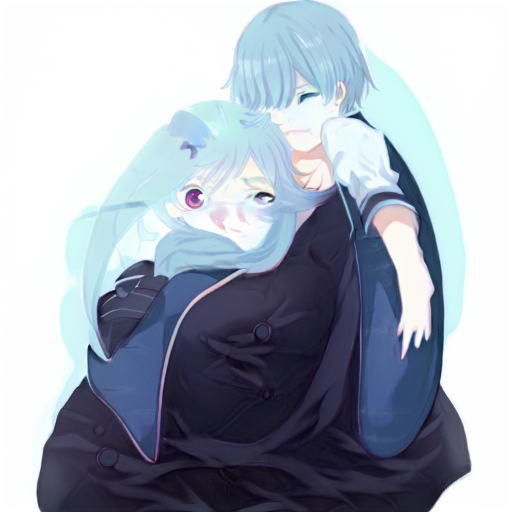

In [223]:
display(displayLatent(result))

In [224]:
result=optimize(result,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

score0 0.262698
new best score 15 0.26269877
new best score 17 0.26271325
new best score 23 0.26272348
new best score 24 0.26273465
new best score 34 0.2627576
new best score 36 0.262765
reset delta 38
new best score 54 0.26278016
new best score 57 0.26279607
new best score 59 0.2628752
new best score 64 0.26289925
reset delta 75


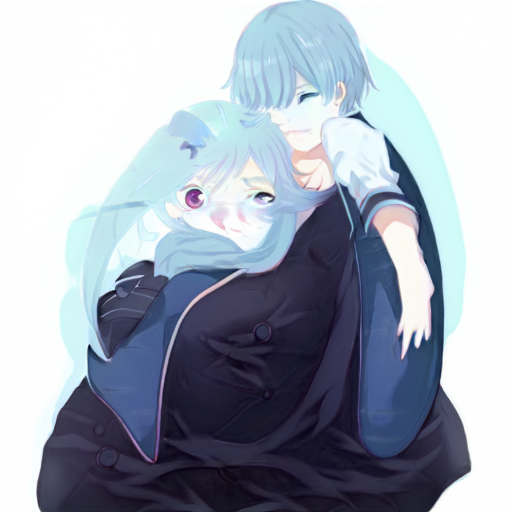

In [225]:
display(displayLatent(result))

text input torch.Size([1, 77])


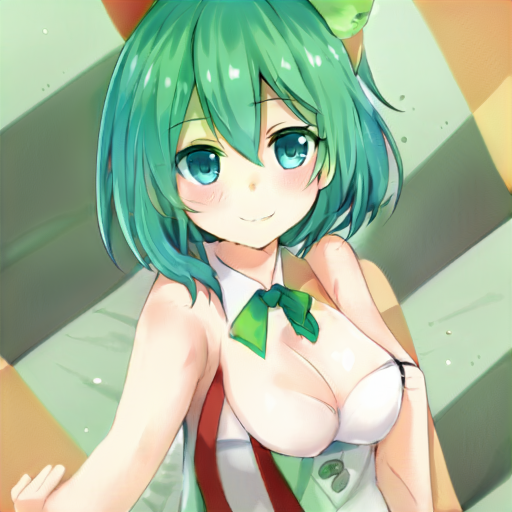

score0 0.11405891
new best score 0 0.13492604
new best score 2 0.13744484
new best score 3 0.14577326
new best score 6 0.14686923
new best score 7 0.14739503
new best score 9 0.15146029
new best score 10 0.15592411
new best score 11 0.15721865
new best score 14 0.15834029
new best score 16 0.15888642
new best score 17 0.15974669
new best score 18 0.1614548
new best score 20 0.1625728
new best score 21 0.16312464
new best score 23 0.16358462
new best score 27 0.16364484
new best score 28 0.16379307
new best score 32 0.16382383
new best score 35 0.1639063
new best score 36 0.16399293
new best score 41 0.16401033
reset delta 53
reset delta 86
new best score 87 0.18860984
new best score 90 0.19213799
new best score 92 0.19276203
new best score 93 0.19465908
new best score 94 0.19913672
new best score 95 0.20028976
new best score 97 0.20140374
new best score 99 0.20140782


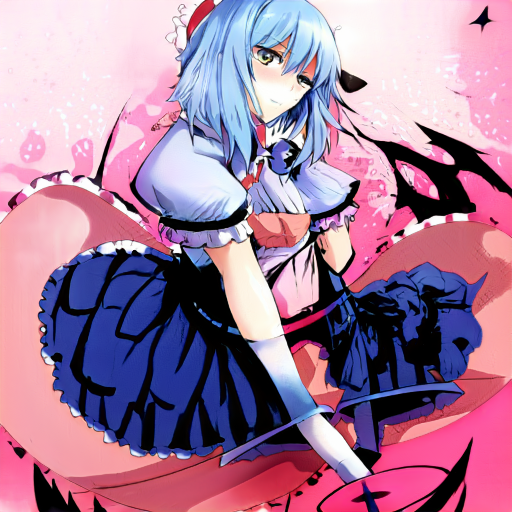

In [227]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl wearing a pink tutu",psi=0.5)
start=np.random.randn(*latent.shape)
display(displayLatent(start))
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

score0 0.2014579
new best score 3 0.20297948
new best score 4 0.20539156
new best score 6 0.20718412
new best score 7 0.21286742
new best score 8 0.21288285
new best score 11 0.21758333
new best score 12 0.21965297
new best score 13 0.22092994
new best score 15 0.22143643
new best score 16 0.22181451
new best score 18 0.22198021
new best score 20 0.22253539
new best score 21 0.22255488
new best score 28 0.2226153
new best score 31 0.22266243
new best score 34 0.22271203
new best score 35 0.2227402
new best score 47 0.22276646
reset delta 50
reset delta 83
new best score 93 0.22277486
new best score 94 0.22285031
new best score 96 0.22320731
new best score 97 0.2233065


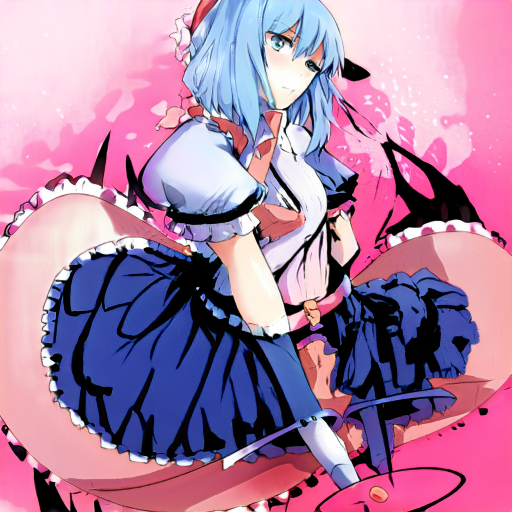

In [228]:
result=optimize(result,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

text input torch.Size([1, 77])


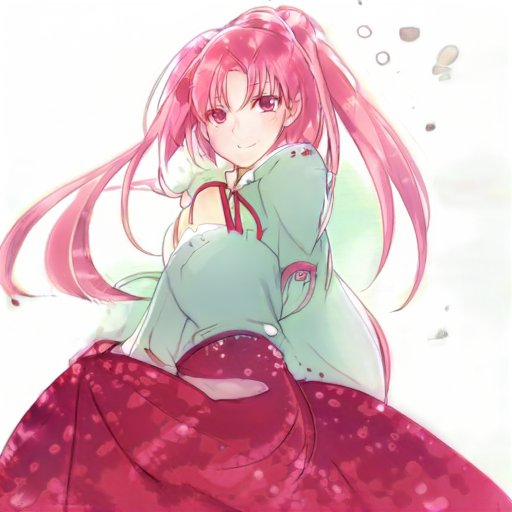

score0 0.15494554
new best score 0 0.16378814
new best score 1 0.175809
new best score 4 0.18397437
new best score 5 0.188169
new best score 6 0.19021879
new best score 8 0.19292243
new best score 10 0.19722013
new best score 14 0.19748372
new best score 15 0.19859669
new best score 23 0.19892031
new best score 24 0.1989505
new best score 25 0.1991221
new best score 30 0.1991507
new best score 31 0.19916067
new best score 33 0.19920921
new best score 35 0.19922933
new best score 42 0.19923274
reset delta 49
new best score 51 0.20078427
new best score 53 0.2046313
new best score 54 0.2128081
new best score 56 0.22106454
new best score 57 0.22198048
new best score 58 0.2231061
new best score 61 0.2291393
new best score 63 0.22981378
new best score 66 0.23072305
new best score 67 0.2310853
new best score 68 0.23175628
new best score 69 0.23178637
new best score 70 0.23218788
new best score 71 0.23238032
new best score 72 0.2326467
new best score 74 0.23278601
new best score 75 0.23289841


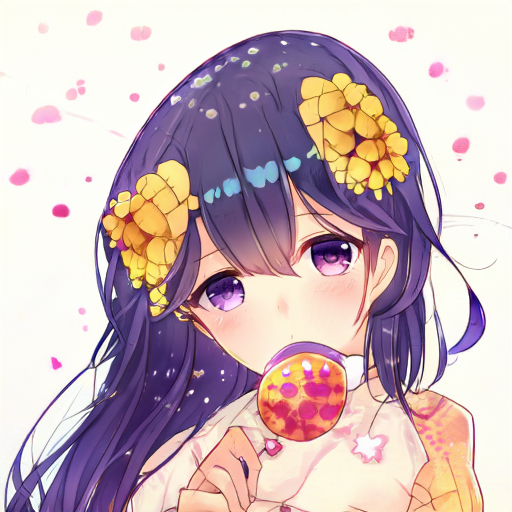

In [229]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl wearing a yellow polka dot bikini",psi=0.5)
start=np.random.randn(*latent.shape)
display(displayLatent(start))
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

text input torch.Size([1, 77])


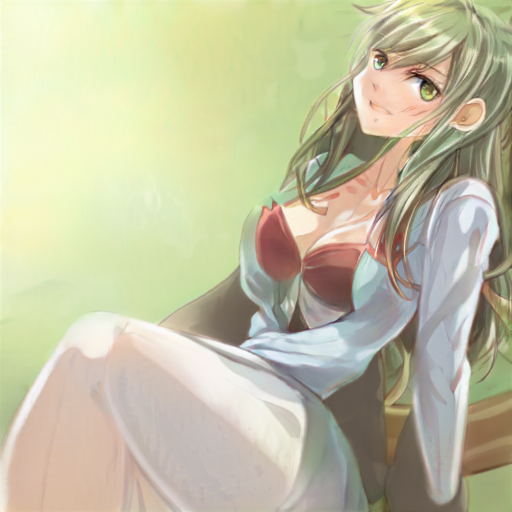

score0 0.11559135
new best score 0 0.16899401
new best score 1 0.17393091
new best score 3 0.18402681
new best score 4 0.18925
new best score 5 0.19173388
new best score 9 0.19851182
new best score 10 0.19908401
new best score 12 0.199716
new best score 13 0.20137663
new best score 14 0.20426017
new best score 15 0.2109206
new best score 17 0.21146107
new best score 18 0.21201624
new best score 19 0.21355632
new best score 22 0.21393846
new best score 26 0.21406123
new best score 28 0.21410525
new best score 30 0.21422505
new best score 31 0.21427396
new best score 34 0.21427962
new best score 36 0.21428737
new best score 37 0.2142875
new best score 38 0.21435486
new best score 40 0.21439472
new best score 45 0.21444571
reset delta 57
new best score 87 0.21446748
reset delta 91


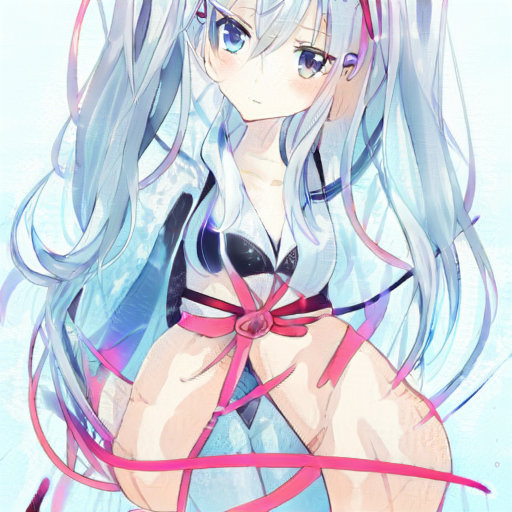

In [231]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl dressed like a zebra",psi=0.5)
start=np.random.randn(*latent.shape)
display(displayLatent(start))
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

text input torch.Size([1, 77])


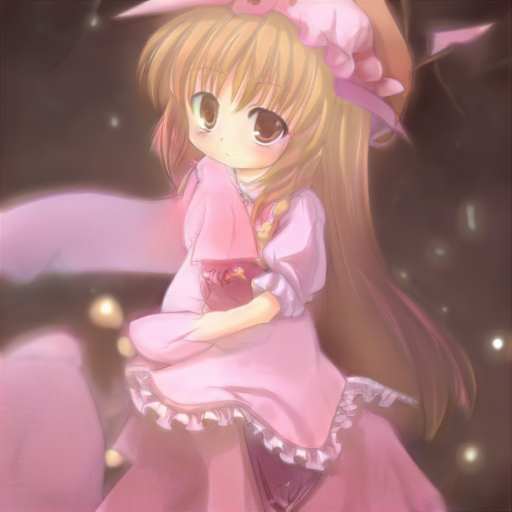

score0 0.13504787
new best score 0 0.17005192
new best score 1 0.1748279
new best score 3 0.17720117
new best score 5 0.1921996
new best score 6 0.2017954
new best score 7 0.21054685
new best score 8 0.21266027
new best score 9 0.22050536
new best score 12 0.2243198
new best score 13 0.22667465
new best score 14 0.2270046
new best score 15 0.22979298
new best score 19 0.23058523
new best score 21 0.23095486
new best score 22 0.23126344
new best score 23 0.23136146
new best score 24 0.23247209
new best score 25 0.23352382
new best score 26 0.23396748
new best score 30 0.23408547
new best score 31 0.234132
new best score 32 0.23413421
new best score 34 0.23439854
new best score 35 0.23448062
new best score 39 0.23450276
new best score 40 0.23452479
new best score 41 0.23454934
new best score 44 0.23458034
new best score 45 0.23458245
new best score 46 0.23460516
new best score 48 0.2347679
reset delta 63
new best score 68 0.23606093
new best score 70 0.23641181
new best score 72 0.238692

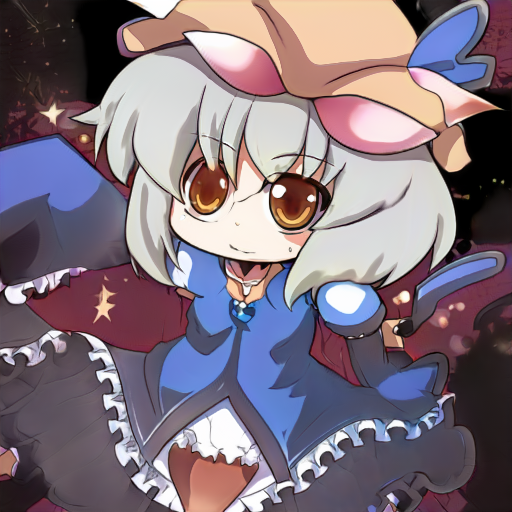

In [236]:
latent,scoreLatents,displayLatent=doTheWork(description="a boy wearing a cowboy hat",psi=0.5)
start=np.random.randn(*latent.shape)
display(displayLatent(start))
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))


[0.19528794 0.19944891 0.20093855 0.20316914 0.20425384]


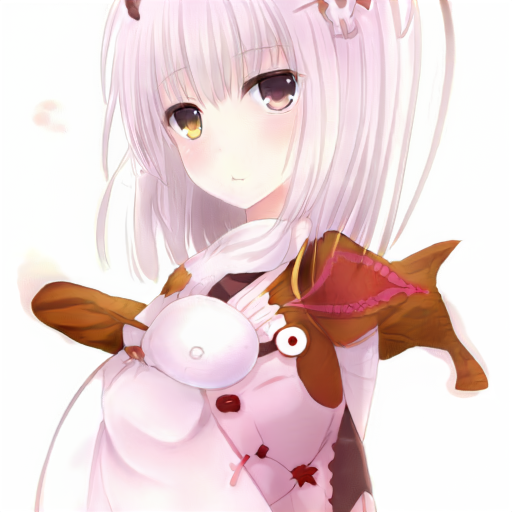

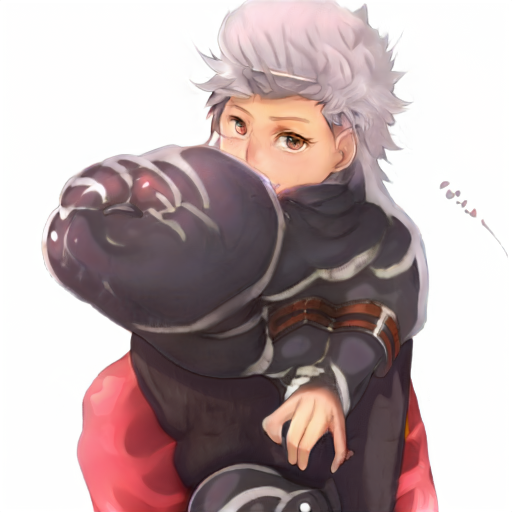

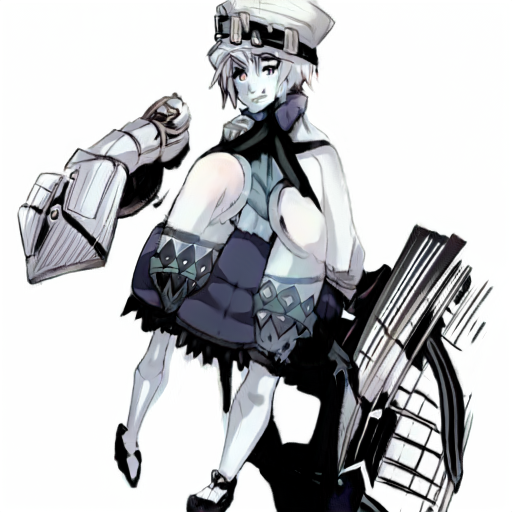

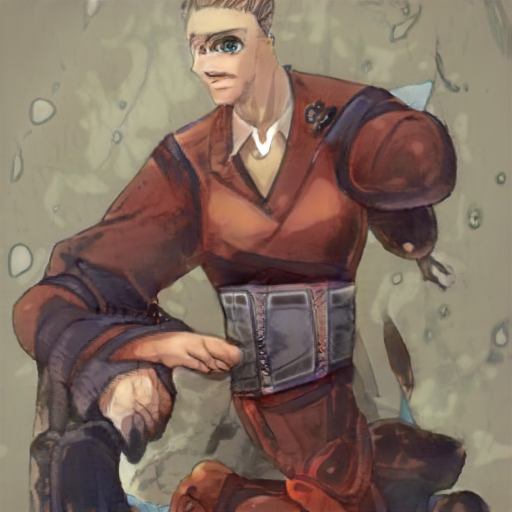

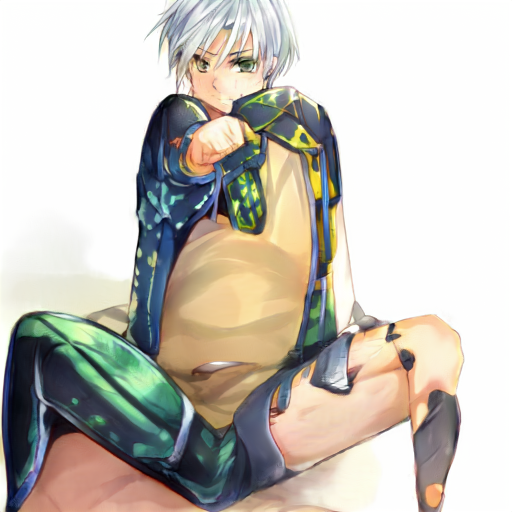

In [237]:
#how much worse is this than random sampling?
randomBatch=[np.random.randn(*latent.shape) for i in range(1000)]
scores=[scoreLatents(l) for l in tqdm(randomBatch)]
np.max(scores)
top5=np.argsort(np.array(scores).flatten())[-5:] #normal distribution is key not not getting hideous monstrosoties!
print(np.array(scores).flatten()[top5])
[display(displayLatent(randomBatch[t])) for t in top5]
top5Latents=[randomBatch[t] for t in top5]

score0 0.20314416
new best score 2 0.20563889
new best score 3 0.20655432
new best score 4 0.20994723
new best score 5 0.21747948
new best score 7 0.23044229
new best score 10 0.23387799
new best score 12 0.23631763
new best score 15 0.2367371
new best score 16 0.23715341
new best score 17 0.2387613
new best score 19 0.23880294
new best score 20 0.2390276
new best score 21 0.23941973
new best score 22 0.23979115
new best score 23 0.24048758
new best score 24 0.24088544
new best score 26 0.2411431
new best score 29 0.24121545
new best score 31 0.24127755
new best score 32 0.24128684
new best score 34 0.24138361
new best score 37 0.24141453
new best score 38 0.241602
new best score 43 0.24164698
new best score 44 0.24164906
reset delta 57
reset delta 90


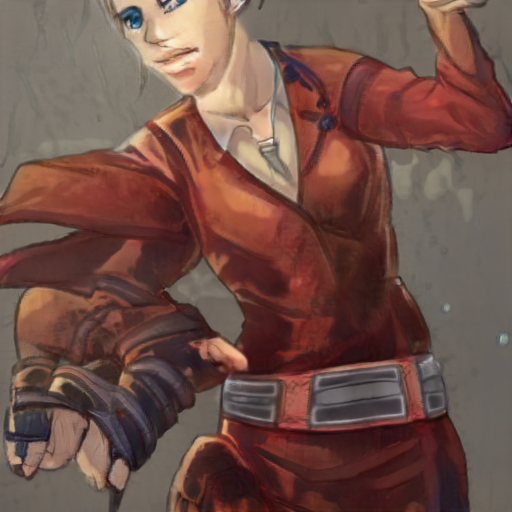

In [238]:
result=optimize(top5Latents[3],scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

text input torch.Size([1, 77])


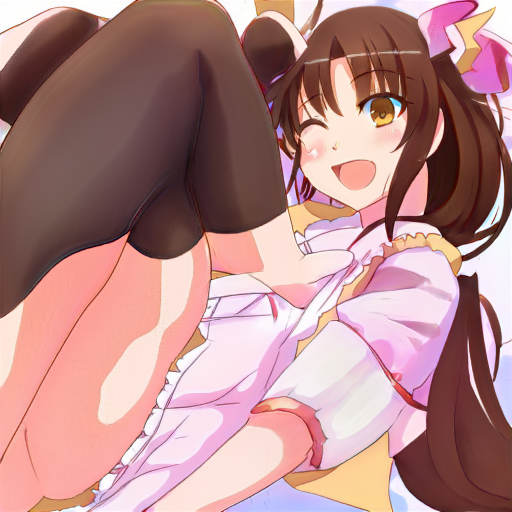

score0 0.16653936
new best score 0 0.2006273
new best score 1 0.21499619
new best score 4 0.2156249
new best score 5 0.22045532
new best score 6 0.2316989
new best score 8 0.23344049
new best score 10 0.24307
new best score 12 0.24714538
new best score 13 0.24854848
new best score 16 0.25098464
new best score 17 0.25378615
new best score 19 0.2539749
new best score 20 0.2544068
new best score 21 0.2545569
new best score 23 0.2549727
new best score 24 0.25558975
new best score 26 0.25587547
new best score 27 0.25623667
new best score 28 0.25668523
new best score 30 0.25693244
new best score 34 0.2569851
new best score 37 0.2570128
new best score 43 0.2570236
new best score 45 0.2570431
new best score 48 0.2570489
new best score 50 0.25705492
new best score 52 0.25706318
reset delta 59
reset delta 92


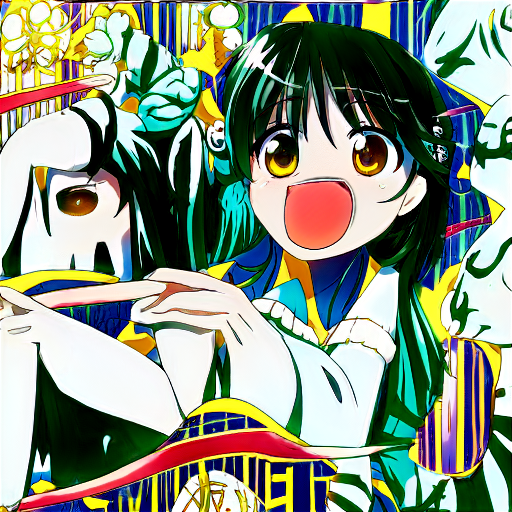

In [245]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl covered in blood",psi=2.0)
start=np.random.randn(*latent.shape)
display(displayLatent(start))
result=optimize(start,scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))


[0.22164088 0.22307274 0.22351761 0.22386143 0.22864139]


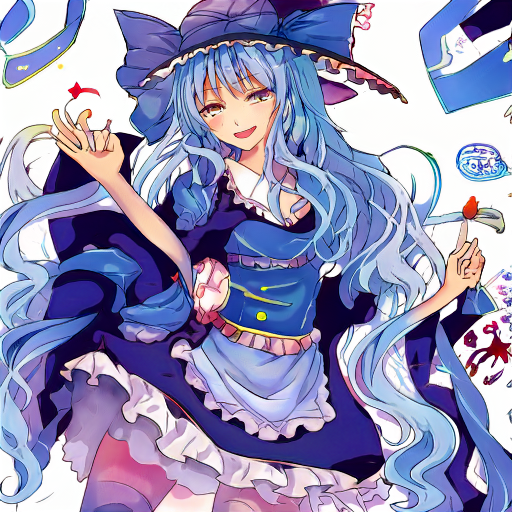

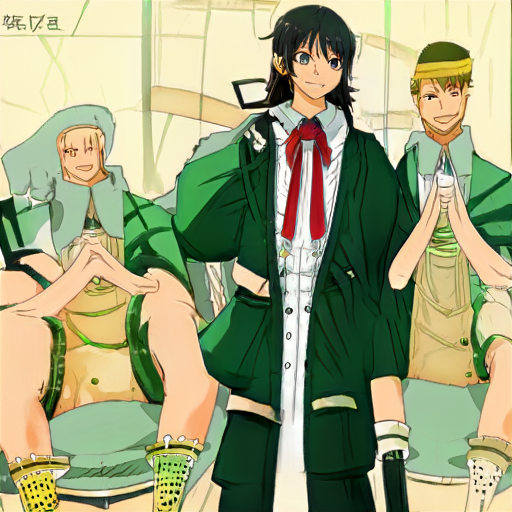

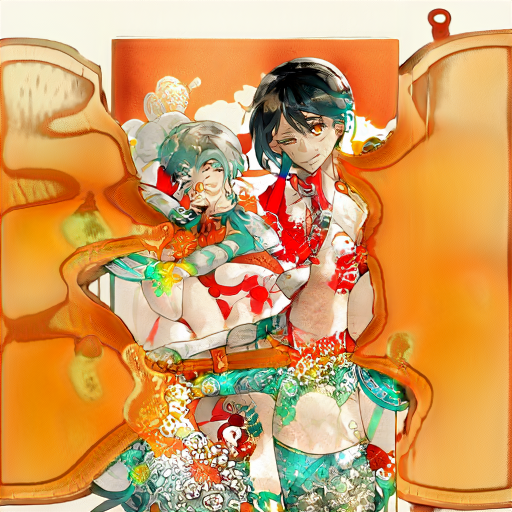

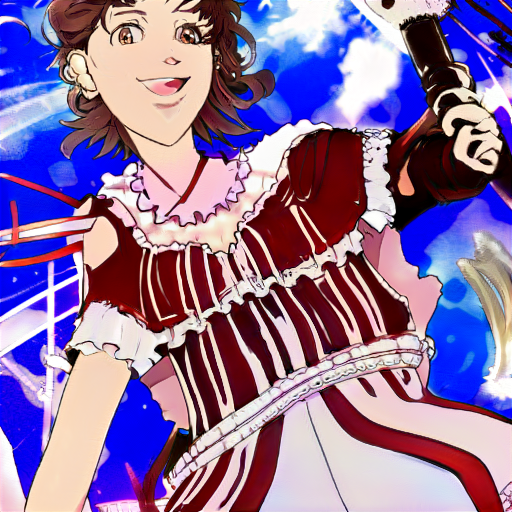

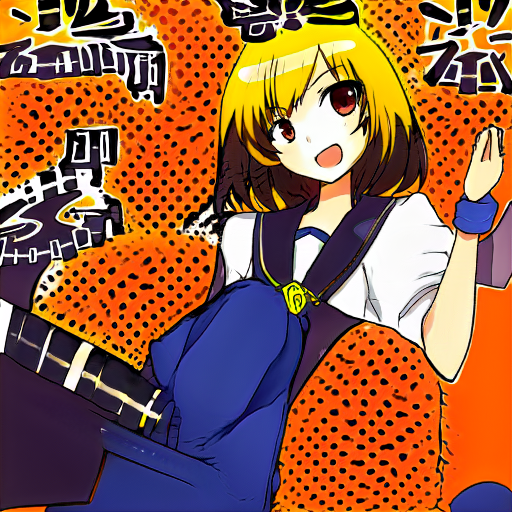

In [246]:
#how much worse is this than random sampling?
randomBatch=[np.random.randn(*latent.shape) for i in range(1000)]
scores=[scoreLatents(l) for l in tqdm(randomBatch)]
np.max(scores)
top5=np.argsort(np.array(scores).flatten())[-5:] #normal distribution is key not not getting hideous monstrosoties!
print(np.array(scores).flatten()[top5])
[display(displayLatent(randomBatch[t])) for t in top5]
top5Latents=[randomBatch[t] for t in top5]

score0 0.22869238
new best score 9 0.22892326
new best score 11 0.22895491
new best score 12 0.22921038
new best score 13 0.22976822
new best score 14 0.22988187
new best score 15 0.23002572
new best score 16 0.23021588
new best score 17 0.23058027
new best score 18 0.23059404
new best score 19 0.23094554
new best score 20 0.23125176
new best score 21 0.23166096
new best score 22 0.23173216
new best score 23 0.23180851
new best score 24 0.2323634
new best score 26 0.2323795
new best score 27 0.2324155
new best score 30 0.23251772
new best score 31 0.23253389
new best score 35 0.23260312
new best score 42 0.23261958
new best score 48 0.23262581
reset delta 54
new best score 69 0.23266098
new best score 71 0.23270923
new best score 73 0.23284206
new best score 77 0.23293296
new best score 78 0.23294258
new best score 81 0.23295027
reset delta 93


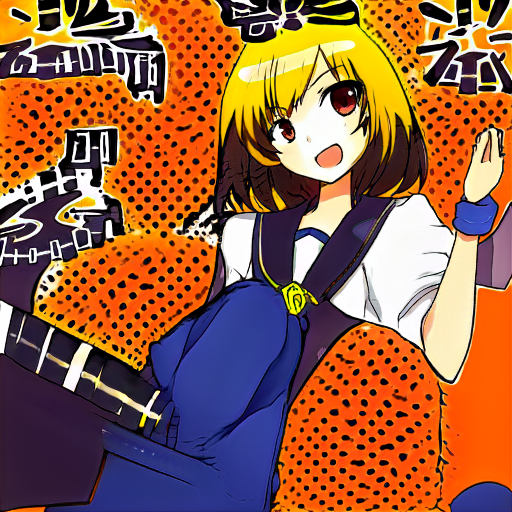

In [247]:
result=optimize(top5Latents[4],scoreLatents,rounds=100,_density=1,_delta=1)
display(displayLatent(result))

#Trying out a collapse algorithm:
*generate a bunch of things
*take the top scoring ones and pair them
*score the averages of the pairs
*repeat

In [293]:
from itertools import combinations

def collapse(scoreLatents,n=1000,k=30,rounds=3,epsilon=0.0001):
  #generate n things and score them
  randomBatch=[np.random.randn(*latent.shape) for i in range(n)]
  scores=[scoreLatents(l) for l in tqdm(randomBatch)]

  topK=np.argsort(np.array(scores).flatten())[-k:]
  #print(np.array([scores[i] for i in topK]).flatten())

  lastBatch=randomBatch
  lastBatchScores=scores
  lastTopK=topK

  for round in range(rounds):

    thisBatch=[]
    thisScore=[]
    for i,j in (combinations(lastTopK[-k:],2)):
      r=(lastBatch[i]+lastBatch[j])/2
      s=scoreLatents(r)
      thisBatch+=[r]
      thisScore+=[s]
    
    thisTopK=np.argsort(np.array(thisScore).flatten())[-k:]
    #print(np.array([thisScore[i] for i in thisTopK]).flatten())
    print("round",round,"improvement",thisScore[thisTopK[-1]],">",lastBatchScores[lastTopK[0]])

    if thisScore[thisTopK[-1]] - lastBatchScores[lastTopK[0]] < epsilon:
      break

    lastBatch+=[thisBatch[i] for i in thisTopK]
    lastBatchScores+=[thisScore[i] for i in thisTopK]
    lastTopK=np.argsort(np.array(lastBatchScores).flatten())[-k:]

  return lastBatch[lastTopK[-1]]





In [283]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl covered in blood",psi=2.0)
result=collapse(scoreLatents,n=100,k=10,rounds=100)


text input torch.Size([1, 77])



[0.19291997 0.19294252 0.19340445 0.19559568 0.1959042  0.19741546
 0.19831091 0.20149702 0.20446122 0.2231138 ]
round 0 improvement [0.22004017] > [0.19291997]
round 1 improvement [0.24285603] > [0.20149702]
round 2 improvement [0.23491909] > [0.21380153]
round 3 improvement [0.23772389] > [0.2274627]
round 4 improvement [0.24267347] > [0.23370868]
round 5 improvement [0.24093351] > [0.23558244]
round 6 improvement [0.25152043] > [0.23728302]
round 7 improvement [0.25482136] > [0.23933889]
round 8 improvement [0.2549733] > [0.24630499]
round 9 improvement [0.25519165] > [0.25446382]
round 10 improvement [0.25522998] > [0.25502297]
round 11 improvement [0.25521865] > [0.25516126]
round 12 improvement [0.25521433] > [0.25519228]
round 13 improvement [0.25527927] > [0.25519818]
round 14 improvement [0.25525266] > [0.25520486]
round 15 improvement [0.255235] > [0.25520808]
round 16 improvement [0.25523138] > [0.25521433]
round 17 improvement [0.2552194] > [0.25521606]


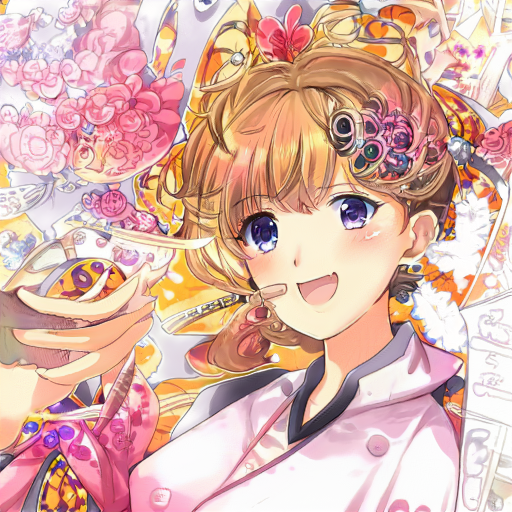

In [284]:
display(displayLatent(result))

text input torch.Size([1, 77])



[0.20299189 0.20362629 0.20454502 0.20546947 0.20571363 0.20605998
 0.20752022 0.2085482  0.20892137 0.21069063 0.2107261  0.21141908
 0.21361406 0.21422516 0.2144683  0.22025155 0.22220683 0.22371574
 0.22389589 0.22520533]
round 0 improvement [0.24569061] > [0.20299189]
round 1 improvement [0.26431316] > [0.22141415]
round 2 improvement [0.26713663] > [0.2367962]
round 3 improvement [0.2797999] > [0.24972793]
round 4 improvement [0.2893283] > [0.2598279]
round 5 improvement [0.2911179] > [0.27180406]
round 6 improvement [0.2911911] > [0.28707394]
round 7 improvement [0.29199588] > [0.28825587]
round 8 improvement [0.29199225] > [0.29187986]
round 9 improvement [0.29197723] > [0.29193062]
round 10 improvement [0.29199904] > [0.2919452]
round 11 improvement [0.29197973] > [0.29195297]
round 12 improvement [0.29198116] > [0.29195774]
round 13 improvement [0.29201114] > [0.29196182]
round 14 improvement [0.2919737] > [0.29196572]


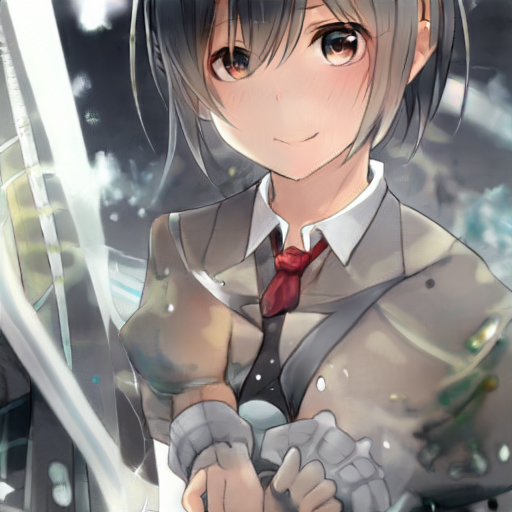

In [287]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl holding an umbrella",psi=2.0)
result=collapse(scoreLatents,n=100,k=20,rounds=40)
display(displayLatent(result))

text input torch.Size([1, 77])



[0.15052608 0.15074913 0.15679376 0.15685841 0.15941255 0.16117272
 0.16390187 0.16445869 0.16462256 0.16815242 0.1690884  0.16934872
 0.17012562 0.17402738 0.17592362 0.17811589 0.17892589 0.18540955
 0.19370139 0.21021312]
round 0 improvement [0.21710446] > [0.15052608]
round 1 improvement [0.2293663] > [0.18632069]
round 2 improvement [0.2533311] > [0.2078739]
round 3 improvement [0.2553587] > [0.22422251]
round 4 improvement [0.26603624] > [0.23621485]
round 5 improvement [0.2681126] > [0.2524978]
round 6 improvement [0.26943275] > [0.25960466]
round 7 improvement [0.26946896] > [0.2687974]
round 8 improvement [0.2694657] > [0.2694193]


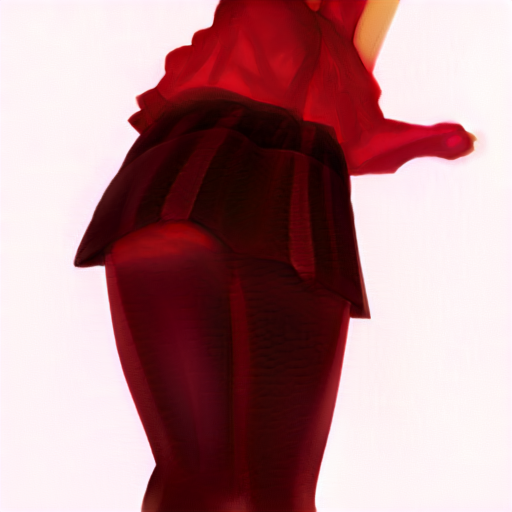

In [291]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl wearing a red skirt",psi=2.0)
result=collapse(scoreLatents,n=100,k=20,rounds=40)
display(displayLatent(result))

text input torch.Size([1, 77])



[0.16214088 0.16277665 0.16416496 0.16518836 0.16697405 0.16727446
 0.16748814 0.1678569  0.1682049  0.16955245 0.16963238 0.17044455
 0.17135993 0.17353196 0.17958154 0.17974822 0.18039651 0.18279928
 0.194291   0.24795204]
round 0 improvement [0.24004105] > [0.16214088]
round 1 improvement [0.2552389] > [0.18724628]
round 2 improvement [0.26808774] > [0.228955]
round 3 improvement [0.27410713] > [0.2514337]
round 4 improvement [0.27598837] > [0.25989354]
round 5 improvement [0.27906287] > [0.27077162]
round 6 improvement [0.27908713] > [0.27595526]
round 7 improvement [0.27945316] > [0.2774253]
round 8 improvement [0.27948955] > [0.27902025]
round 9 improvement [0.27952677] > [0.27943468]


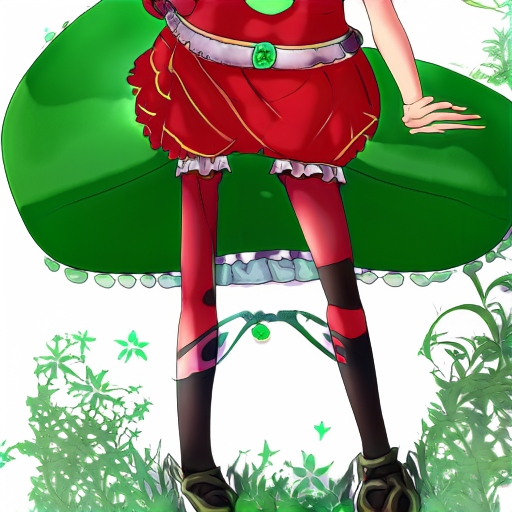

In [292]:
latent,scoreLatents,displayLatent=doTheWork(description="an anime drawing of a girl wearing a red skirt",psi=2.0)
result=collapse(scoreLatents,n=100,k=20,rounds=40)
display(displayLatent(result))

text input torch.Size([1, 77])



round 0 improvement [0.27226263] > [0.24182475]
round 1 improvement [0.2869869] > [0.26100963]
round 2 improvement [0.29164952] > [0.27023393]
round 3 improvement [0.29280108] > [0.27545428]
round 4 improvement [0.30375797] > [0.28188354]
round 5 improvement [0.30134907] > [0.29247615]
round 6 improvement [0.3060967] > [0.29625526]
round 7 improvement [0.30528748] > [0.30126423]
round 8 improvement [0.30627042] > [0.3026709]
round 9 improvement [0.3078181] > [0.30501845]
round 10 improvement [0.30748773] > [0.30629748]
round 11 improvement [0.30751407] > [0.3071974]
round 12 improvement [0.30788976] > [0.3074456]
round 13 improvement [0.30790794] > [0.30748653]
round 14 improvement [0.30827755] > [0.3077395]
round 15 improvement [0.30816957] > [0.30790475]
round 16 improvement [0.30825907] > [0.30801204]
round 17 improvement [0.3083505] > [0.30815026]
round 18 improvement [0.30831367] > [0.30826724]


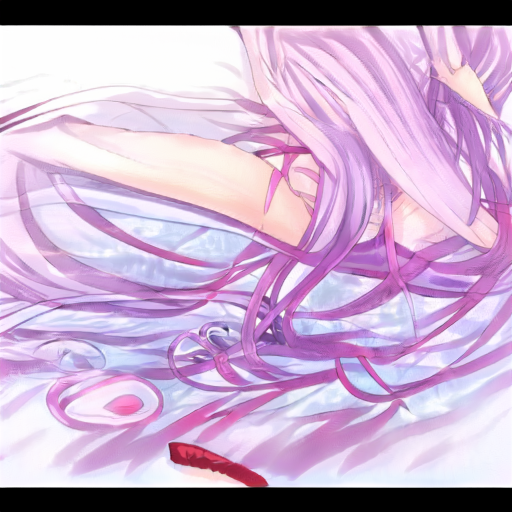

In [294]:
latent,scoreLatents,displayLatent=doTheWork(description="an anime drawing of a girl wearing a red dress",psi=2.0)
result=collapse(scoreLatents,n=100,k=20,rounds=40)
display(displayLatent(result))

text input torch.Size([1, 77])



round 0 improvement [0.27823716] > [0.20767263]
round 1 improvement [0.2823957] > [0.24937868]
round 2 improvement [0.2977343] > [0.2703313]
round 3 improvement [0.3016991] > [0.28453064]
round 4 improvement [0.30363858] > [0.29525816]
round 5 improvement [0.30438757] > [0.3015576]
round 6 improvement [0.30438375] > [0.3042907]


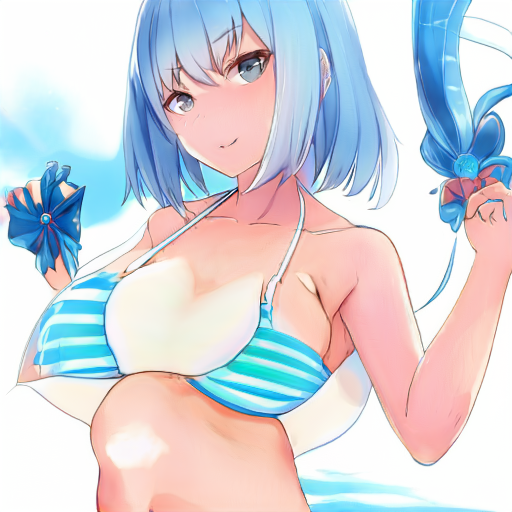

In [295]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl wearing a blue bikini",psi=2.0)
result=collapse(scoreLatents,n=1000,k=30,rounds=40)
display(displayLatent(result))

text input torch.Size([1, 77])



round 0 improvement [0.20405585] > [0.16098852]
round 1 improvement [0.22004604] > [0.18365891]
round 2 improvement [0.225492] > [0.19854423]
round 3 improvement [0.22748722] > [0.21133097]
round 4 improvement [0.22846135] > [0.21928072]
round 5 improvement [0.23092723] > [0.22302735]
round 6 improvement [0.23162086] > [0.22747993]
round 7 improvement [0.23235792] > [0.22945938]
round 8 improvement [0.23386201] > [0.23148973]
round 9 improvement [0.23430425] > [0.23330338]
round 10 improvement [0.23428793] > [0.23419324]


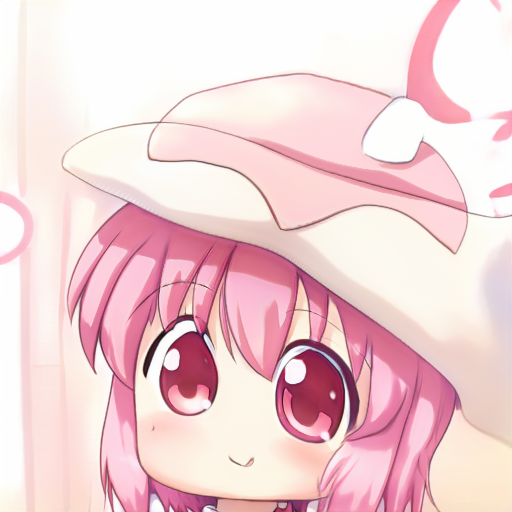

In [310]:
latent,scoreLatents,displayLatent=doTheWork(description="a girl with a pink hat",psi=2.0)
result=collapse(scoreLatents,n=400,k=20,rounds=40)
display(displayLatent(result))